# <center><font size="+3.95"> Clustering models on Amazon Fine foods reviews dataset.


 * In the below notebook we are about to perform different unsupervised learning model(Clustering) on the Amazon fine foods dataset.
 

 * We are given a 500K datset of reviews from Amazon customers regarding the various food products.
 

 * We will be using 4 types of Vectorizations to convert text reviews into vectors and we will analyze the different clsutering algorithms like k-means, Agglomerative and DBSCAN clusterings .

In [1]:
import pandas as pd
import numpy as np
import sqlite3
import graphviz
import wordcloud
import pickle
import math
from sklearn.preprocessing import StandardScaler
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import DBSCAN
from wordcloud import WordCloud
#from tqdm import tqdm

In [2]:
import seaborn as sns
import matplotlib.pyplot as plt

In [3]:
import warnings
warnings.filterwarnings('ignore')

In [4]:
con=sqlite3.connect('G:\ML\Data_Sets\Amazon\Cleaned_AmazonDB.sqlite')

In [5]:
data=pd.read_sql_query('''Select * from Reviews''',con)

In [7]:
data.shape

(364171, 13)

In [114]:
data['Score'].value_counts()

positive    307061
negative     57110
Name: Score, dtype: int64

Since the data here is imbalanced we will use the <b>class_weight</b> parameter in our DT model as <b>'Balanced'</b>.

## Time based sorting of data:

In [6]:
sorted_data=data.sort_values('Time',axis=0,ascending=True)

In [8]:
sorted_data.shape

(364171, 13)

In [10]:
sorted_data.head()

,level_0,index,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,New
0,0,138706,150524,0006641040,ACITT7DI6IDDL,shari zychinski,0,0,positive,939340800,EVERY book is educational,this witty little book makes my son laugh at l...,witti littl book make son laugh loud recit car...
30,30,138683,150501,0006641040,AJ46FKXOVC7NR,Nicholas A Mesiano,2,2,positive,940809600,This whole series is great way to spend time w...,I can remember seeing the show when it aired o...,rememb see show air televis year child sister ...
424,424,417839,451856,B00004CXX9,AIUWLEQ1ADEG5,Elizabeth Medina,0,0,positive,944092800,Entertainingl Funny!,Beetlejuice is a well written movie ..... ever...,beetlejuic well written movi everyth excel act...
330,330,346055,374359,B00004CI84,A344SMIA5JECGM,Vincent P. Ross,1,2,positive,944438400,A modern day fairy tale,"A twist of rumplestiskin captured on film, sta...",twist rumplestiskin captur star michael keaton...
423,423,417838,451855,B00004CXX9,AJH6LUC1UT1ON,The Phantom of the Opera,0,0,positive,946857600,FANTASTIC!,Beetlejuice is an excellent and funny movie. K...,beetlejuic excel funni movi keaton hilari wack...


## Finding Optimal_K:

In [8]:
def optimal_k(x,k=[5,10,20,50,70,90,120,150,200]):
    '''
    Function to find optimal value of K for K-Means algorithm
    '''
    list_inertia=[]
    for i in k:
        km=KMeans(n_clusters=i,init='k-means++',n_init=5,random_state=33)
        km.fit(x)
        list_inertia.append(km.inertia_)
        print(f'\n For K value ={i} and inertia is {km.inertia_}')
    plt.figure(figsize=(10,5))
    sns.set_style('darkgrid')
    plt.plot(k,list_inertia)   
    plt.xlabel('K values --> ')
    plt.ylabel('Errors+''('+'Inertia'+')'+'-->')
    plt.title('Variation in K with loss')
    #plt.legend()
    plt.show() 

## Finding K_distance and plotting them for DBSCAN algorithm:

In [8]:
from scipy.spatial.distance import euclidean
from scipy.spatial.distance import pdist,squareform
def K_dist(arr,k):
    '''
    To calculate K distance matrix for DBSCAN.
    '''
    #d=pdist(arr.todense(),metric='euclidean') For BOW & TfIDF
    d=pdist(arr,metric='euclidean') # For W2v models
    k_pt=[]
    distance_pairwise=squareform(d)
    for i in range(distance_pairwise.shape[0]):
        a=np.sort(distance_pairwise[i])
        k_pt.append(a[k])
    return k_pt  

In [9]:
def eps_elbow(arr,k):
    '''
    K distance plot to find Eps of DBSCAN algorithm
    '''
    k_point=K_dist(arr,k)
    k_point.sort()
    plt.figure(figsize=(10,5))
    sns.set_style('darkgrid')
    plt.plot(k_point)
    plt.show()
    

## Word cloud builder for a cluster:

In [8]:
def cloud(df,cluster):
    '''
    To print wordcloud of a cluster with inputs as Dataframe and Cluster number.
    '''
    wc=WordCloud(width=1500,height=1000,background_color='black').generate_from_text(''.join(df['New'][df['Cluster']==cluster]))
    plt.figure(figsize=(15,8))
    plt.imshow(wc)
    plt.axis('off')

# <center><font size="+4.5">  -> Bag Of Words Vectorization <-

# <center>  K Means clustering

In [7]:
BOW=CountVectorizer(dtype='float',min_df=15)

In [8]:
BOW_train= BOW.fit_transform(sorted_data['New'])

In [9]:
BOW_train.shape

(364171, 11831)

In [10]:
scaler=StandardScaler(with_mean=False)
std_BOW_train=scaler.fit_transform(BOW_train[:100000])

### Finding optimal value of K :


 For K value =5 and inertia is 1390706049.636761

 For K value =10 and inertia is 1387497522.2084665

 For K value =20 and inertia is 1385239734.9637573

 For K value =50 and inertia is 1363644842.0527253

 For K value =70 and inertia is 1354188348.6199107

 For K value =90 and inertia is 1342668290.2151952

 For K value =120 and inertia is 1331351599.9646077

 For K value =150 and inertia is 1321151956.9958124

 For K value =200 and inertia is 1301513550.9934862


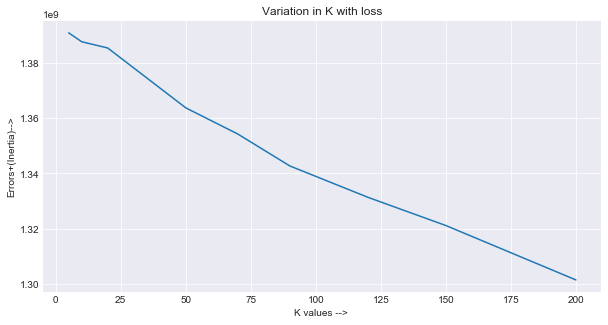

In [15]:
optimal_k(std_BOW_train)

### Implementation:

#### For K value of 20

In [11]:
BOW_KM=KMeans(n_clusters=20,init='k-means++',n_init=10,random_state=33)

In [65]:
BOW_KM.fit(std_BOW_train)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=20, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=33, tol=0.0001, verbose=0)

In [66]:
lb=BOW_KM.labels_
pd.value_counts(lb)

1     90642
4      8972
15       78
6        45
5        41
0        40
8        37
7        36
17       18
14       18
3        18
9        14
16       11
11       10
18        9
12        5
2         2
19        2
10        1
13        1
dtype: int64

In [67]:
BOW_DF=pd.DataFrame(sorted_data['New'][:100000],index=None)
BOW_DF['Cluster']=pd.Series(lb)
BOW_DF.head()

,New,Cluster
0,witti littl book make son laugh loud recit car...,1.0
30,rememb see show air televis year child sister ...,8.0
424,beetlejuic well written movi everyth excel act...,1.0
330,twist rumplestiskin captur star michael keaton...,4.0
423,beetlejuic excel funni movi keaton hilari wack...,1.0


<b> Analysing clusters:

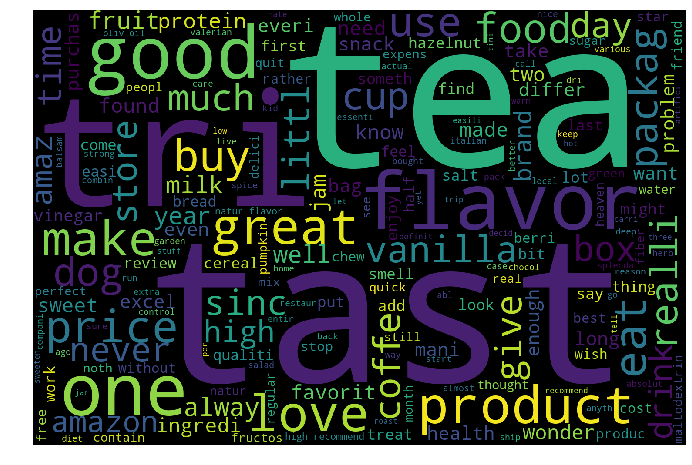

In [71]:
cloud(BOW_DF,15)

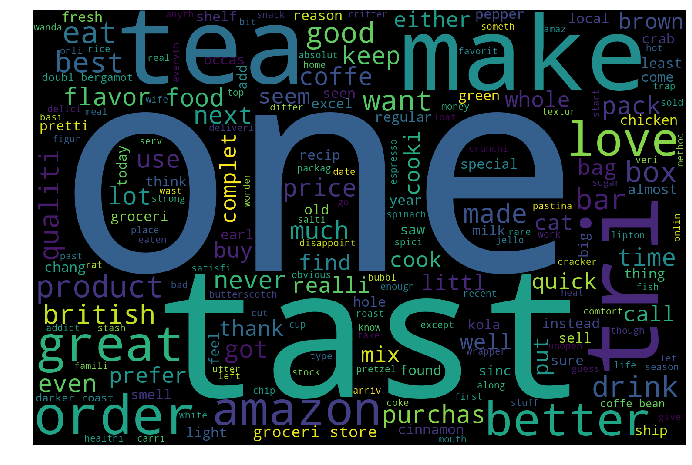

In [72]:
cloud(BOW_DF,6)

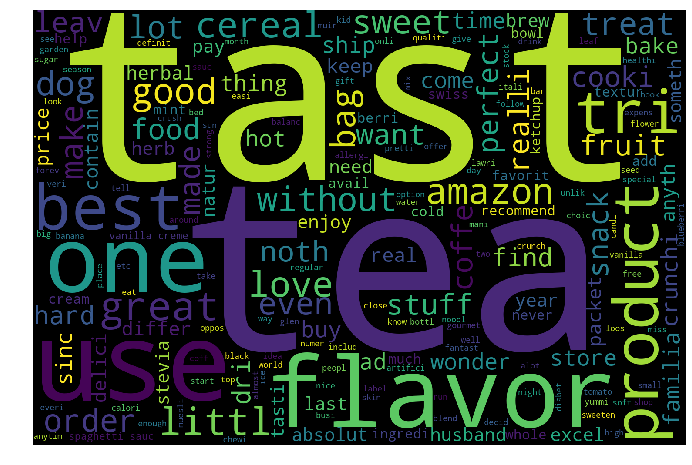

In [73]:
cloud(BOW_DF,5)

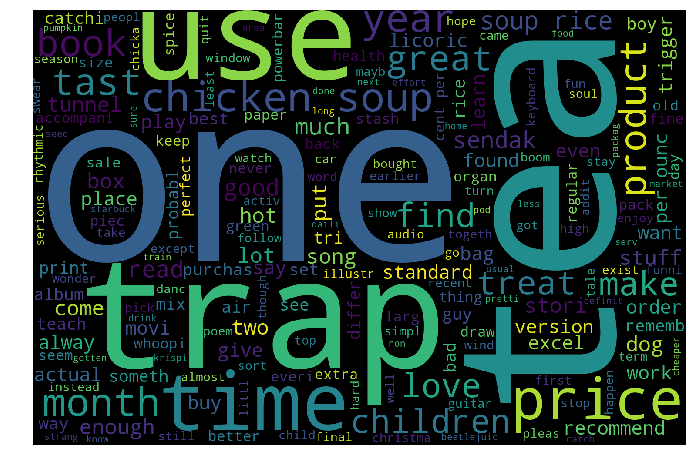

In [74]:
cloud(BOW_DF,8)

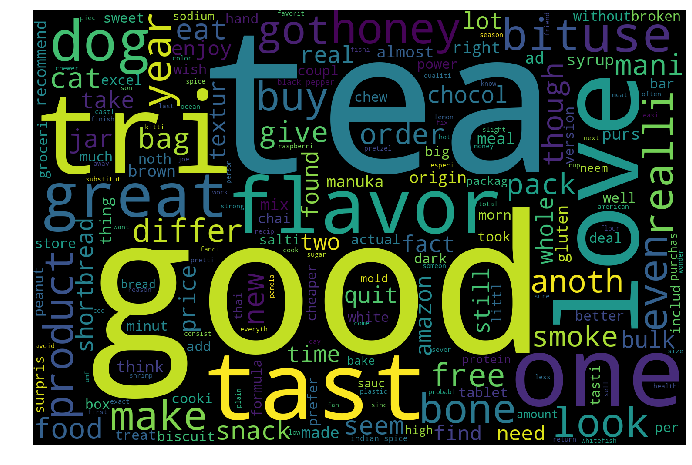

In [75]:
cloud(BOW_DF,7)

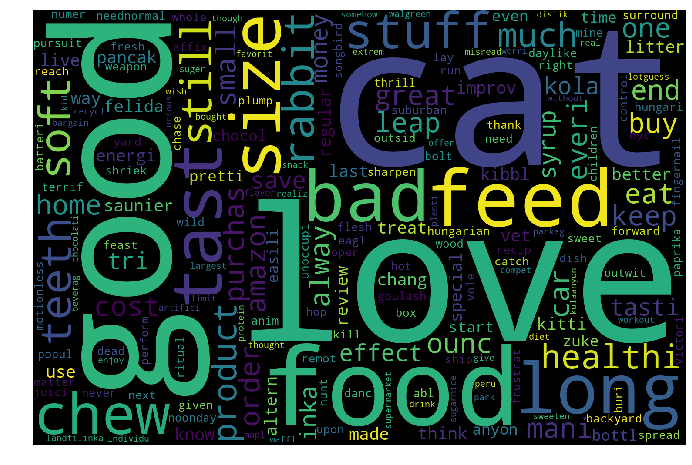

In [76]:
cloud(BOW_DF,17)

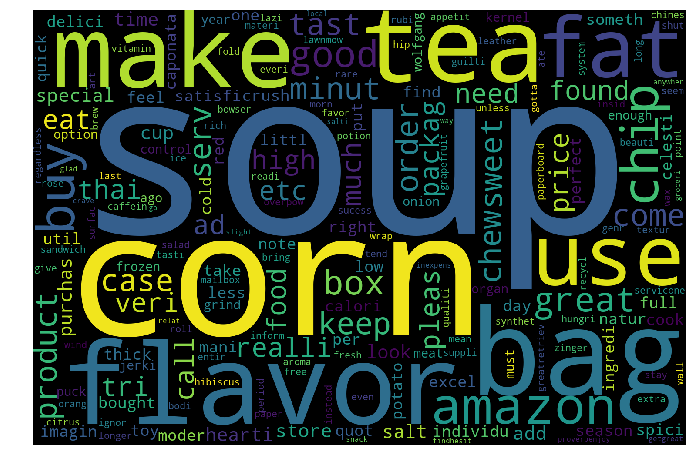

In [77]:
cloud(BOW_DF,14)

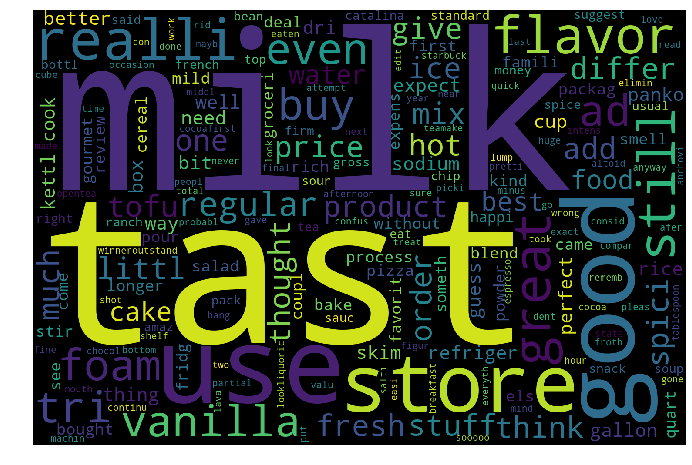

In [78]:
cloud(BOW_DF,3)

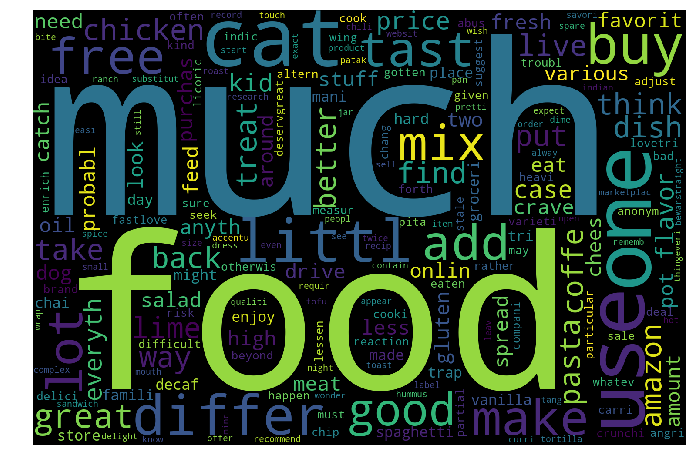

In [79]:
cloud(BOW_DF,9)

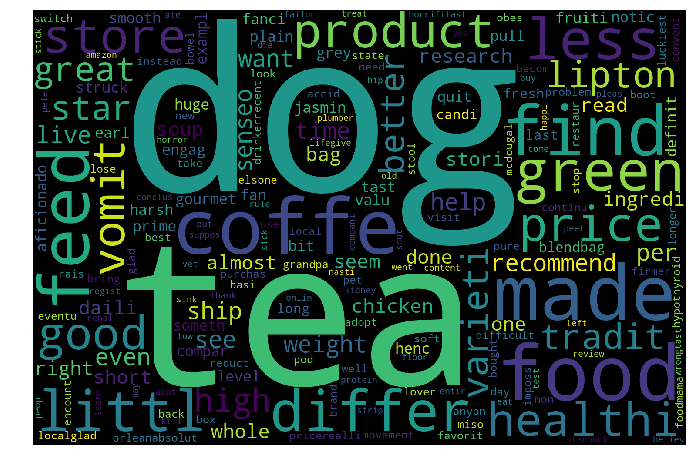

In [80]:
cloud(BOW_DF,16)

### Observations:

On considering number of clusters as 20, we can see that our model seems to be segregating reviews better like for eg: 

Cluster 5 & 15 speaks much about tea and taste.

Cluster 3 - Milk.

Cluster 15- soup & corn.

Cluster 8 -trap.

Cluster 16 - dog.


# <center>  -- Hierarchical clustering - AGGLOMERATIVE --

In [13]:
BOW=CountVectorizer(min_df=3,dtype='float')
BOW_train=BOW.fit_transform(sorted_data['New'][:5000])
BOW_train.shape

(5000, 4642)

In [107]:
model=AgglomerativeClustering(n_clusters=2,linkage='complete')

In [108]:
model.fit(BOW_train.todense())

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='complete', memory=None,
            n_clusters=2,
            pooling_func=<function mean at 0x00000273CD5CB378>)

In [109]:
lb=model.labels_
pd.value_counts(lb)

0    4999
1       1
dtype: int64

In [115]:
list(lb).index(1)

3817

In [118]:
sorted_data['Text'][3817]

"Definitely one of the better tasting hot sauces not the hottest on the market but with all the additional fruits in the ingredients it wasn't made to be the hottest. Try this in ketchup with french fries, the ketchup dilutes some of the heat but leaves the great taste! 5 stars"

With complete linkage, we are not getting proper clustering as we can see from cell[109] that only one point falls under cluster 1 and all other points grouped as cluster 0. Let's try with the default linkage(Ward)

In [119]:
model1=AgglomerativeClustering(n_clusters=2)

In [120]:
model1.fit(BOW_train.todense())

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='ward', memory=None, n_clusters=2,
            pooling_func=<function mean at 0x00000273CD5CB378>)

In [121]:
lb1=model1.labels_
pd.value_counts(lb1)

0    4784
1     216
dtype: int64

So with ward linkage, we are getting better results.

In [124]:
BOW_agg_DF=pd.DataFrame(sorted_data['New'][:5000],index=None)
BOW_agg_DF['Cluster']=pd.Series(lb1)
BOW_agg_DF.head()

,New,Cluster
0,witti littl book make son laugh loud recit car...,0.0
30,rememb see show air televis year child sister ...,0.0
424,beetlejuic well written movi everyth excel act...,0.0
330,twist rumplestiskin captur star michael keaton...,0.0
423,beetlejuic excel funni movi keaton hilari wack...,0.0


In [129]:
with open(r'G:\ML\Pickles\Clustering\Agg_BOW_df_2.pickle','wb') as f:
    pickle.dump(BOW_agg_DF,f)

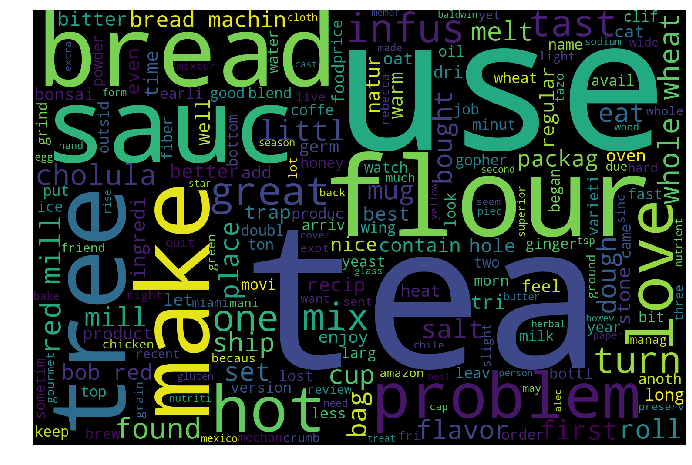

In [125]:
cloud(BOW_agg_DF,1)

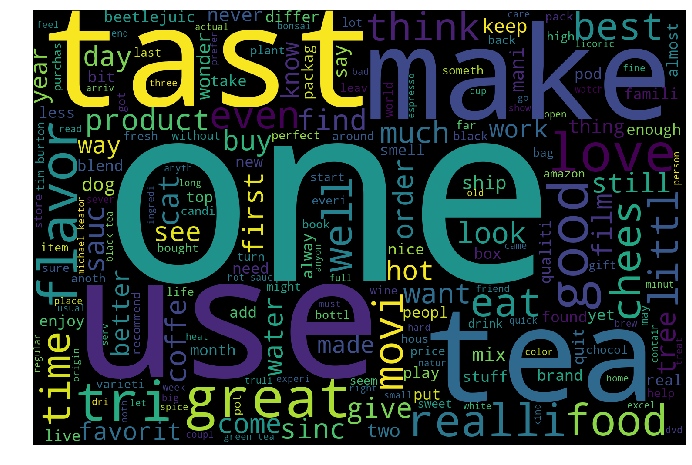

In [126]:
cloud(BOW_agg_DF,0)

<b> Observation:

In cluster 1, we got most frequent terms as product names like flour, bread, sauce, tea & etc whereas in cluster 0 we got the properties of products like taste, flavour, usage etc.

#### 5 Clusters

In [37]:
model=AgglomerativeClustering(n_clusters=5)

In [38]:
model.fit(BOW_train.todense())

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='ward', memory=None, n_clusters=5,
            pooling_func=<function mean at 0x0000022337CAA378>)

In [39]:
lb=model.labels_
pd.value_counts(lb)

0    4770
1     216
2       8
4       5
3       1
dtype: int64

In [40]:
tmp=sorted_data['New'][:5000]
tmp=pd.DataFrame(tmp)
tmp['Cluster']=lb
tmp.Cluster.value_counts()

0    4770
1     216
2       8
4       5
3       1
Name: Cluster, dtype: int64

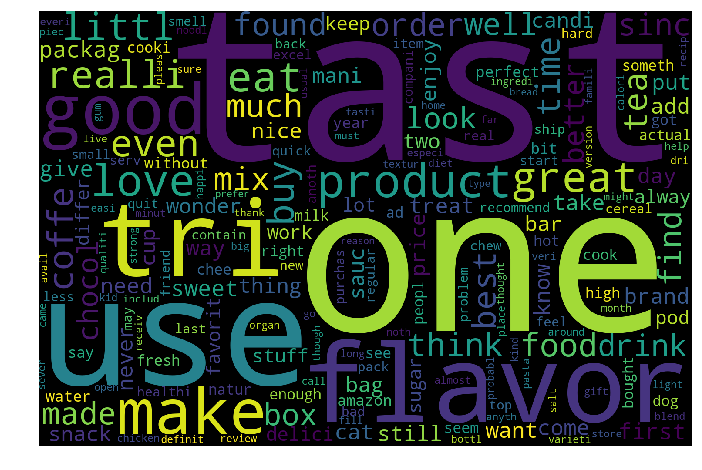

In [41]:
cloud(tmp,0)

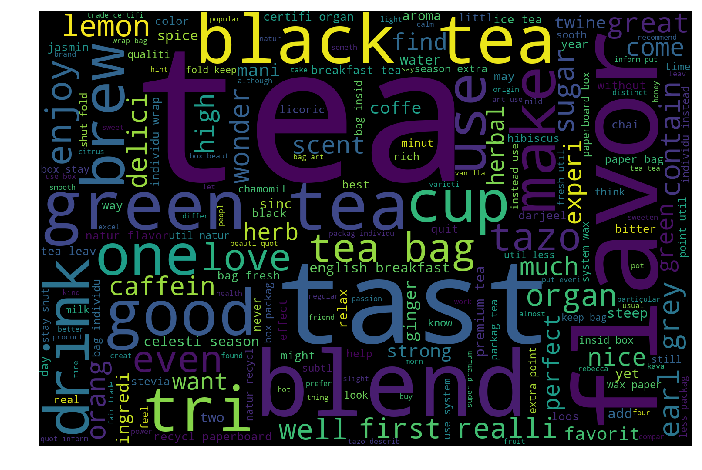

In [42]:
cloud(tmp,1)

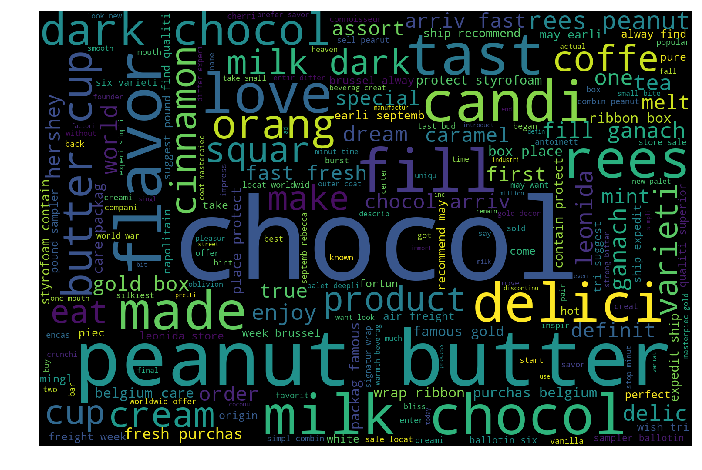

In [43]:
cloud(tmp,2)

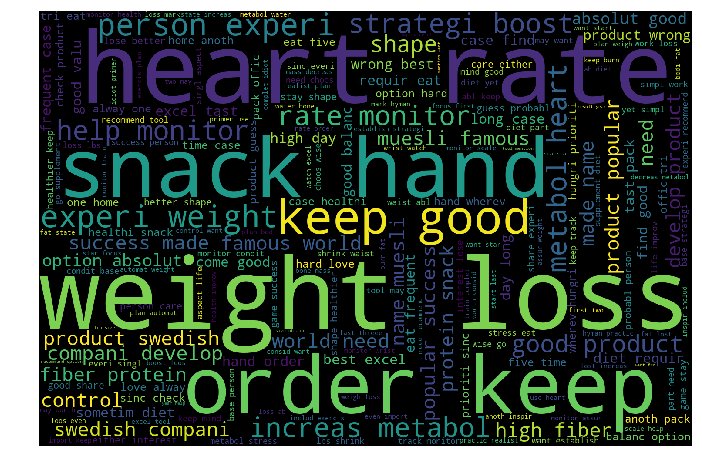

In [44]:
cloud(tmp,4)

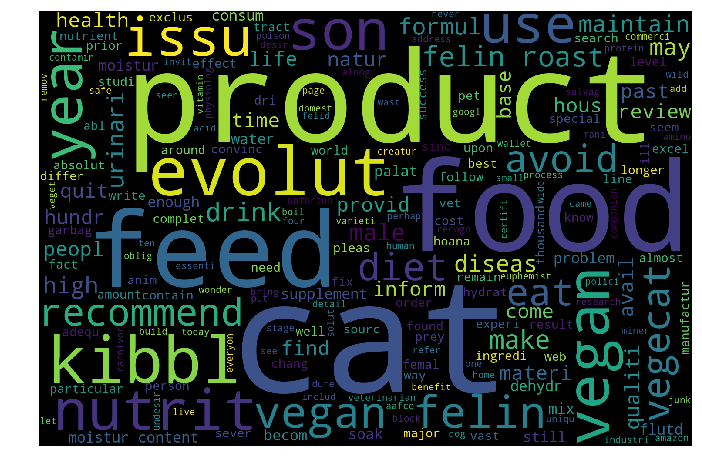

In [45]:
cloud(tmp,3)

<b> Observations :

With n=5, clusters are even more better.

* Cluster 1  Different type of Tea's

* Cluster 2 Chocolates

* Cluster 4 About health topics like weight loss, heart rate etc.

* cluster 3 Cats

* Cluster 0 about most of the popular words in reviews like taste flavor try etc..


#### 7 Clusters

In [18]:
model=AgglomerativeClustering(n_clusters=7)

In [19]:
model.fit(BOW_train.todense())

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='ward', memory=None, n_clusters=7,
            pooling_func=<function mean at 0x0000022337CAA378>)

In [20]:
lb=model.labels_
pd.value_counts(lb)

6    3577
5     906
0     287
1     216
2       8
4       5
3       1
dtype: int64

In [29]:
tmp=sorted_data['New'][:5000]
tmp=pd.DataFrame(tmp)
tmp['Cluster']=lb
tmp.Cluster.value_counts()

6    3577
5     906
0     287
1     216
2       8
4       5
3       1
Name: Cluster, dtype: int64

In [198]:
BOW_agg_DF1=pd.DataFrame(sorted_data['New'][:5000],index=None)
BOW_agg_DF1['Cluster']=pd.Series(lb)
BOW_agg_DF1.isna().any().count()

2

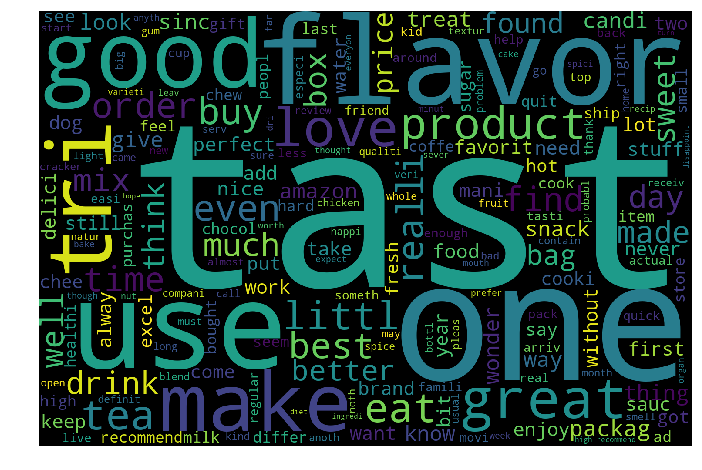

In [30]:
cloud(tmp,6)

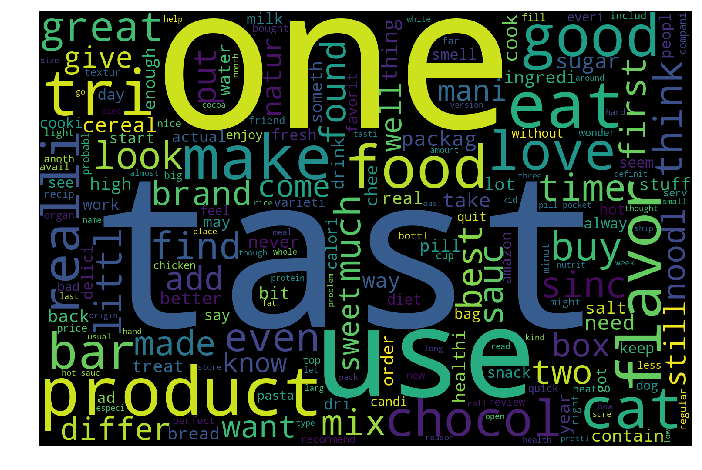

In [31]:
cloud(tmp,5)

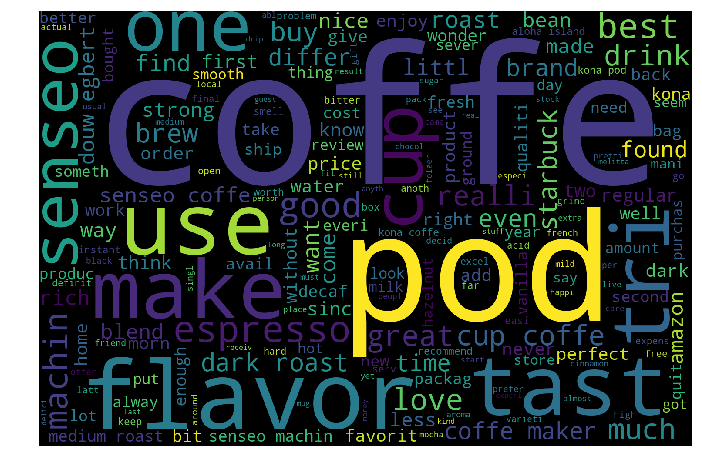

In [32]:
cloud(tmp,0)

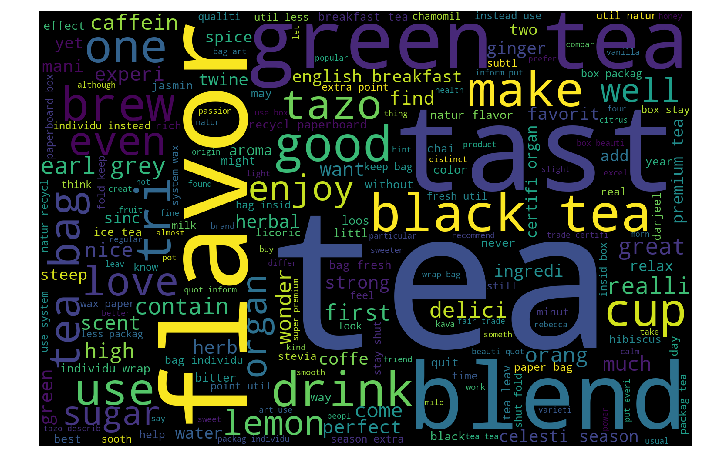

In [33]:
cloud(tmp,1)

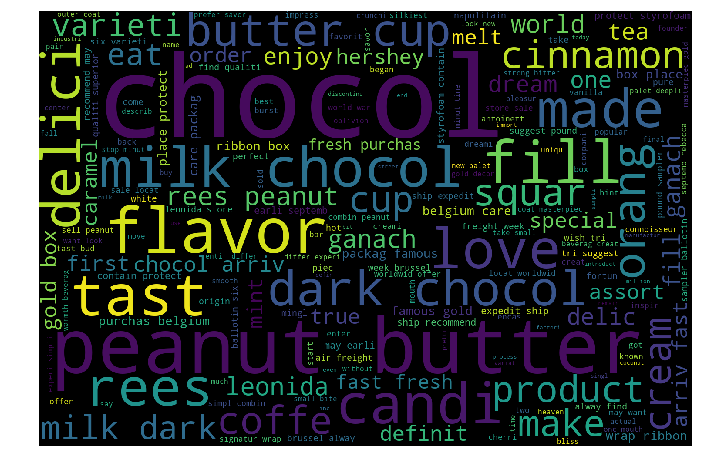

In [34]:
cloud(tmp,2)

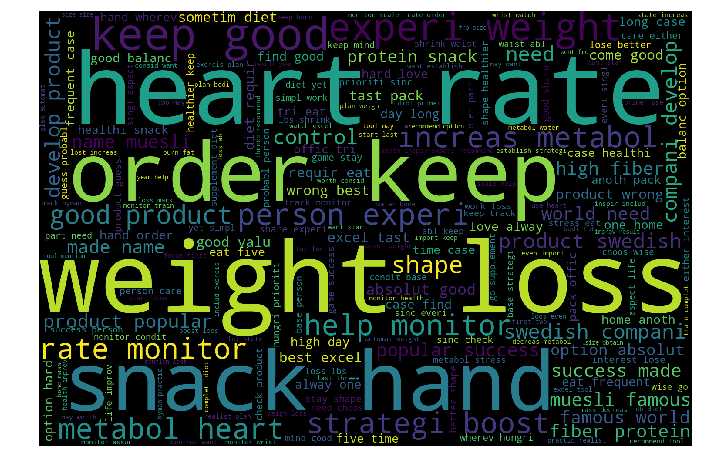

In [35]:
cloud(tmp,4)

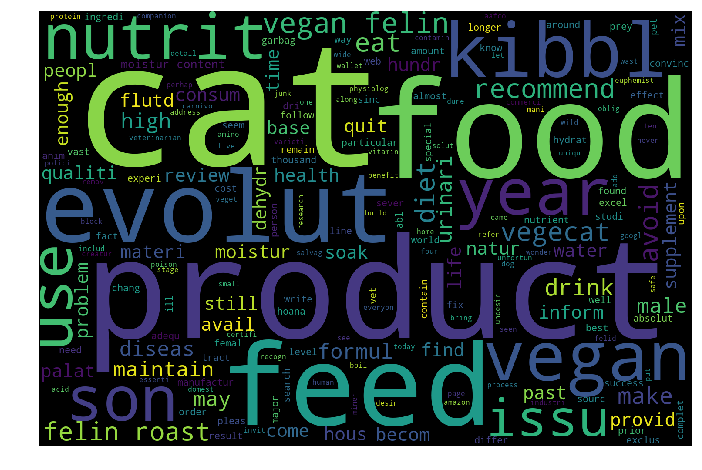

In [36]:
cloud(tmp,3)

<b> Observations : </b>

Below are some of the observations from the clusters formed,

Cluster 0 - Cofee

Cluster 6 - Flavour & taste

Cluster 1 - Tea

Cluster 2 - Chocolate

Cluster 4 - Health reviews.

Cluster 3 - Cat and vegans.



#### 12 Clusters

In [46]:
model=AgglomerativeClustering(n_clusters=12)

In [47]:
model.fit(BOW_train.todense())

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='ward', memory=None, n_clusters=12,
            pooling_func=<function mean at 0x0000022337CAA378>)

In [48]:
lb=model.labels_
pd.value_counts(lb)

2     3577
0      899
5      286
1      156
4       60
6        6
9        5
10       4
11       3
3        2
7        1
8        1
dtype: int64

In [49]:
tmp=sorted_data['New'][:5000]
tmp=pd.DataFrame(tmp)
tmp['Cluster']=lb
tmp.Cluster.value_counts()

2     3577
0      899
5      286
1      156
4       60
6        6
9        5
10       4
11       3
3        2
7        1
8        1
Name: Cluster, dtype: int64

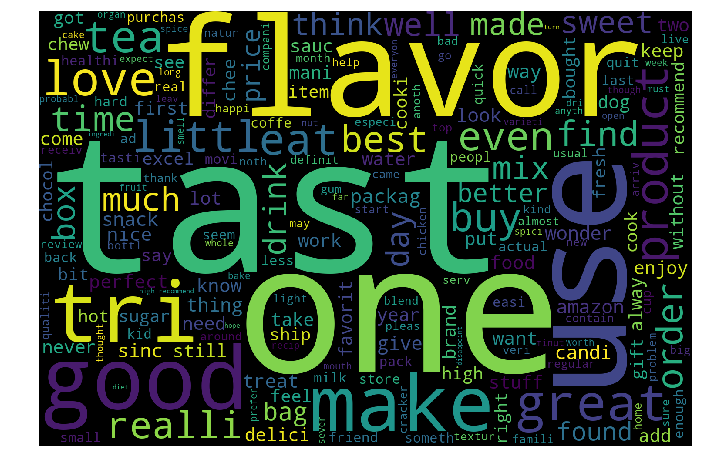

In [50]:
cloud(tmp,2)

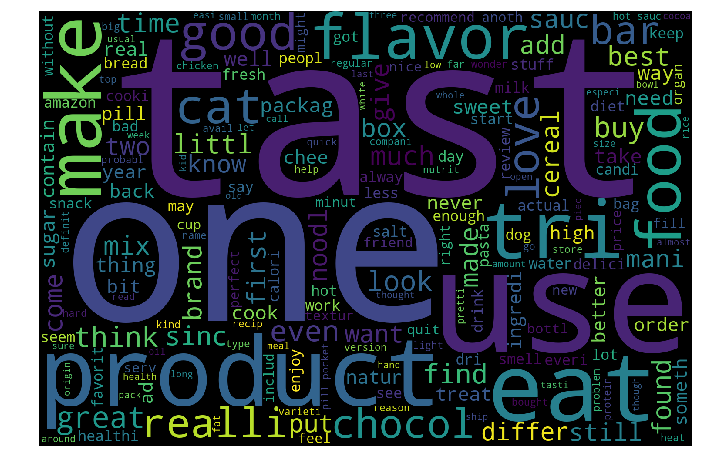

In [51]:
cloud(tmp,0)

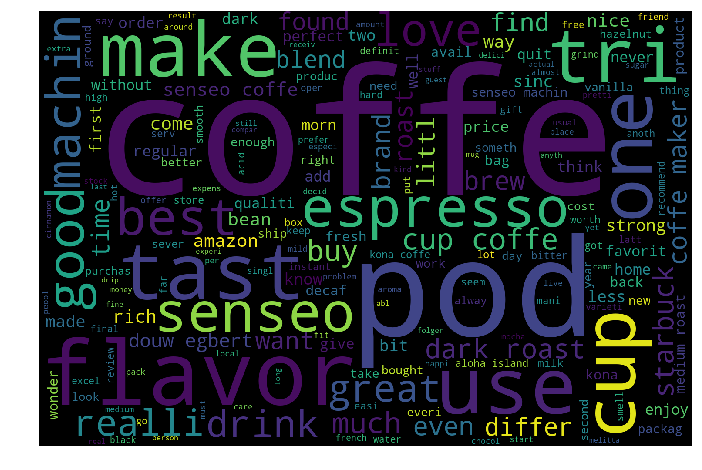

In [52]:
cloud(tmp,5)

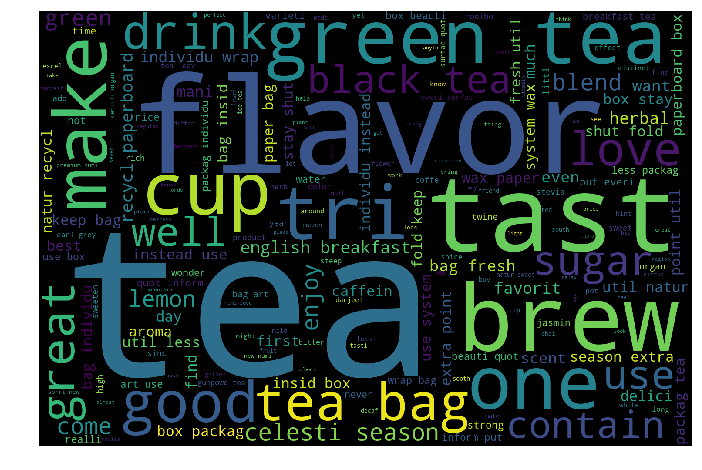

In [54]:
cloud(tmp,1)

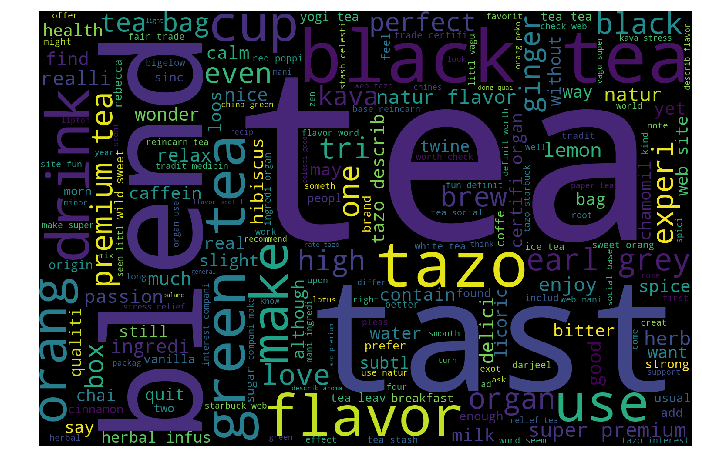

In [55]:
cloud(tmp,4)

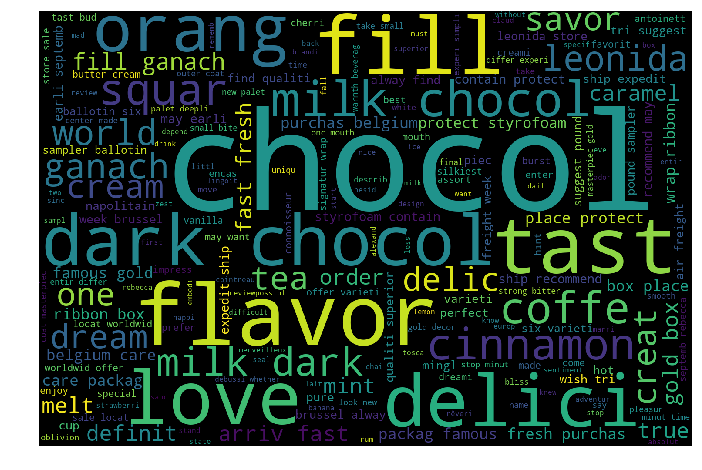

In [56]:
cloud(tmp,6)

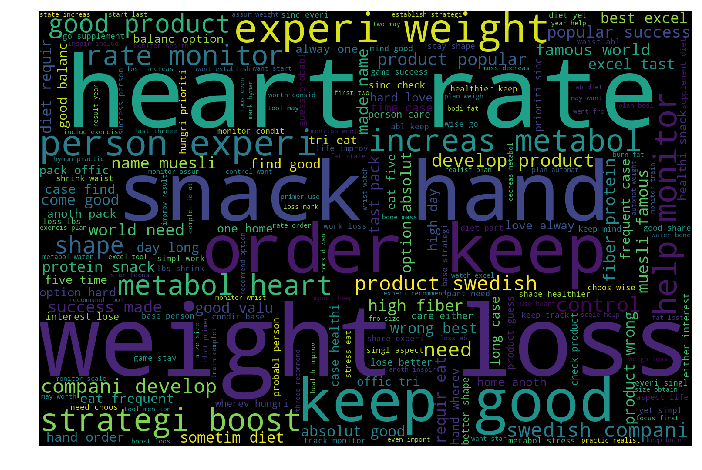

In [57]:
cloud(tmp,9)

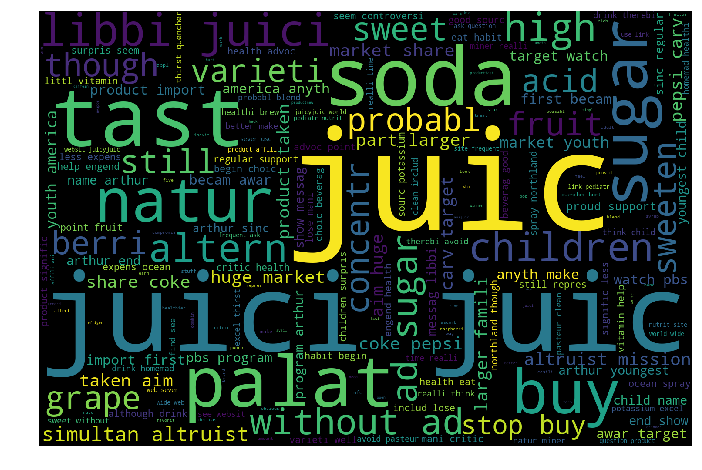

In [58]:
cloud(tmp,10)

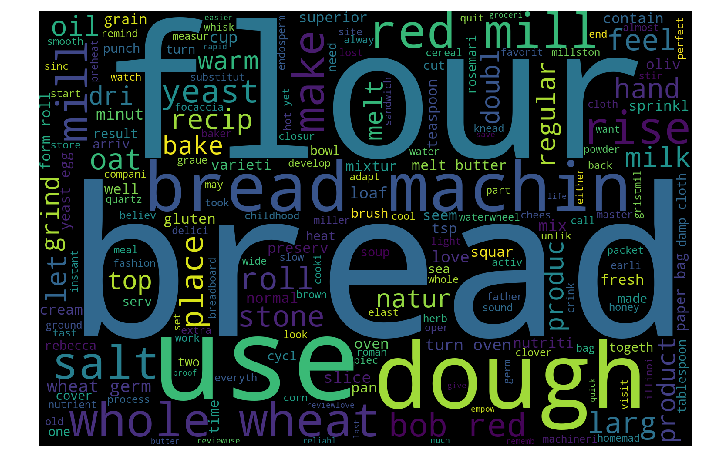

In [59]:
cloud(tmp,11)

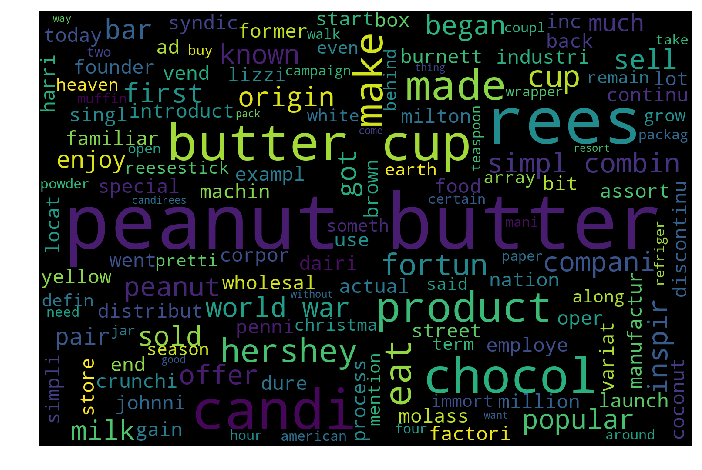

In [60]:
cloud(tmp,3)

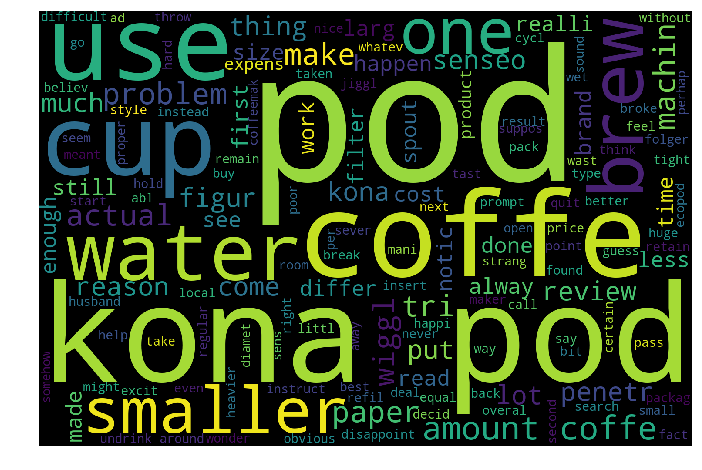

In [61]:
cloud(tmp,7)

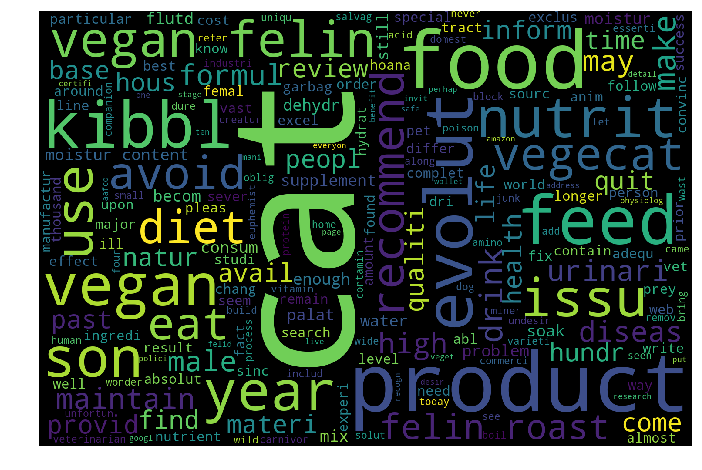

In [62]:
cloud(tmp,8)

<b> Observations : </b>

Below are some of the observations from the clusters formed,

Cluster 0 - Cofee

Cluster 6 - Flavour & taste

Cluster 1 & 4 - Tea, green tea and so on.

Cluster 6 - Chocolate

Cluster 9 - Health reviews.

Cluster 10 - Juice

Cluster 11 - bread & flour

Cluster 3 - Butter

Cluster 8 - Cat.



# <center>  -- DBSCAN  --

In [8]:
BOW=CountVectorizer(dtype='float',min_df=15)

In [9]:
BOW_train= BOW.fit_transform(sorted_data['New'][:30000])

In [10]:
BOW_train.shape

(30000, 3728)

In [11]:
scaler=StandardScaler(with_mean=False)
std_BOW_train=scaler.fit_transform(BOW_train)

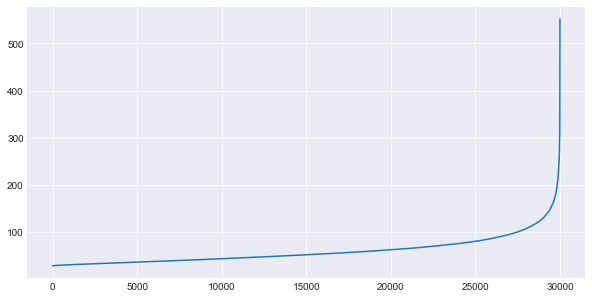

In [22]:
eps_elbow(std_BOW_train,7500)

From the above plot, we can infer that the elbow value for <b> Eps is around 150.

In [23]:
model=DBSCAN(eps=150,min_samples=7500)

In [24]:
model.fit(std_BOW_train)

DBSCAN(algorithm='auto', eps=150, leaf_size=30, metric='euclidean',
    metric_params=None, min_samples=7500, n_jobs=None, p=None)

In [25]:
lb=model.labels_
pd.value_counts(lb)

 0    29618
-1      382
dtype: int64

In [26]:
tmp=sorted_data['New'][:30000]
tmp=pd.DataFrame(tmp)
tmp['Cluster']=lb
tmp.Cluster.value_counts()

 0    29618
-1      382
Name: Cluster, dtype: int64

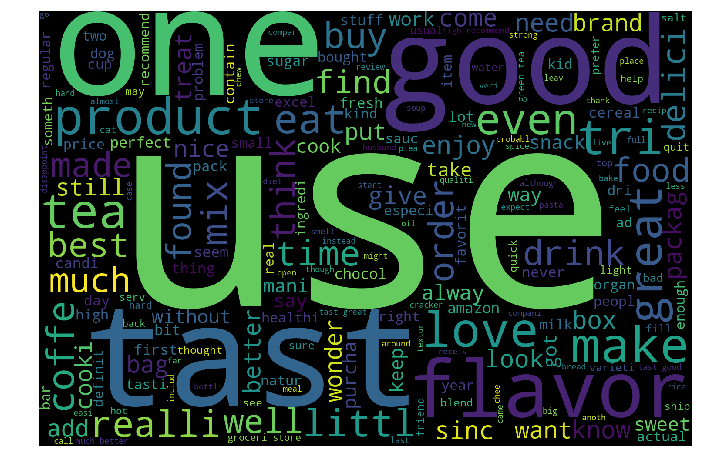

In [27]:
cloud(tmp,0)

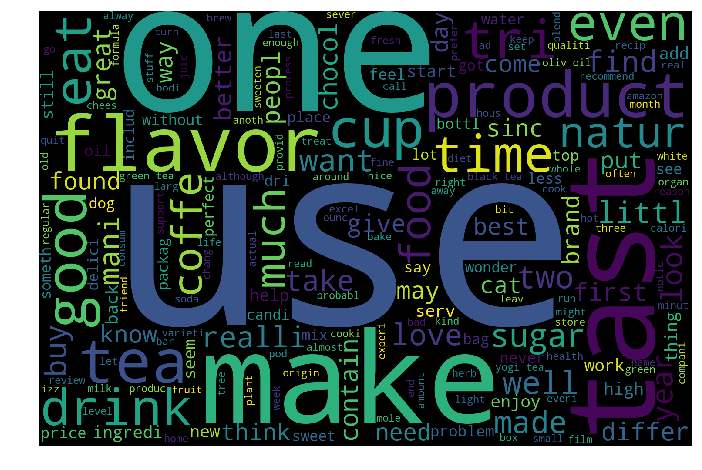

In [28]:
cloud(tmp,-1)

<b> Observations:

DBSCAN just generates two clusters one(0) with all the overlapped points and the other cluster(-1) with the outlier points.

# <center><font size="+4.5"> (ii) TF-IDF Vectorization

# <center> -- K Means clustering --

In [14]:
tfidf=TfidfVectorizer(dtype='float',min_df=10)
tfidf_train=tfidf.fit_transform(sorted_data['New'][:100000])

In [16]:
scaler=StandardScaler(with_mean=False)
std_tfidf_train=scaler.fit_transform(tfidf_train)

### Finding optimal value of K :


 For K value =5 and inertia is 803839487.1761044

 For K value =10 and inertia is 803137993.0123204

 For K value =15 and inertia is 802035424.7524068

 For K value =20 and inertia is 801657693.1967508

 For K value =25 and inertia is 801344391.7891413

 For K value =30 and inertia is 800454278.3159431

 For K value =35 and inertia is 800286477.4005631

 For K value =40 and inertia is 799015901.4083147

 For K value =45 and inertia is 798179682.742435

 For K value =50 and inertia is 798058051.5894328

 For K value =70 and inertia is 796016929.113786


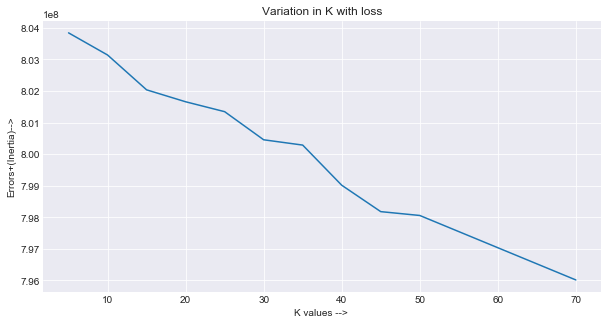

In [101]:
optimal_k(std_tfidf_train,[5,10,15,20,25,30,35,40,45,50,70])

Elbow point occurs at K =15

### Implementation:

In [13]:
tfidf_model=KMeans(n_clusters=15,init='k-means++',n_init=10,random_state=33)

In [14]:
tfidf_model.fit(std_tfidf_train)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=15, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=33, tol=0.0001, verbose=0)

In [15]:
lb=tfidf_model.labels_
pd.value_counts(lb)

5     76818
2     15274
3      6188
7       684
1       491
9       391
8        53
12       23
6        17
13       12
14       11
10       11
0        11
11        8
4         8
dtype: int64

In [20]:
tfidf_DF=pd.DataFrame(sorted_data['New'][:100000])
tfidf_DF['Cluster']=pd.Series(lb)
tfidf_DF.head()

,New,Cluster
0,witti littl book make son laugh loud recit car...,5.0
30,rememb see show air televis year child sister ...,8.0
424,beetlejuic well written movi everyth excel act...,5.0
330,twist rumplestiskin captur star michael keaton...,5.0
423,beetlejuic excel funni movi keaton hilari wack...,3.0


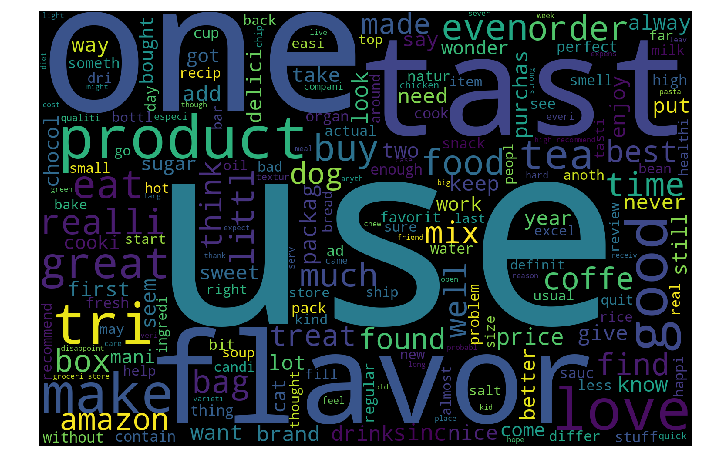

In [23]:
cloud(tfidf_DF,3)

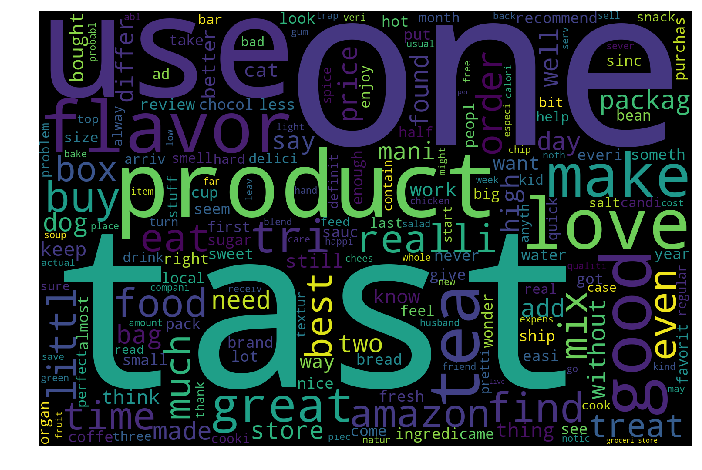

In [24]:
cloud(tfidf_DF,7)

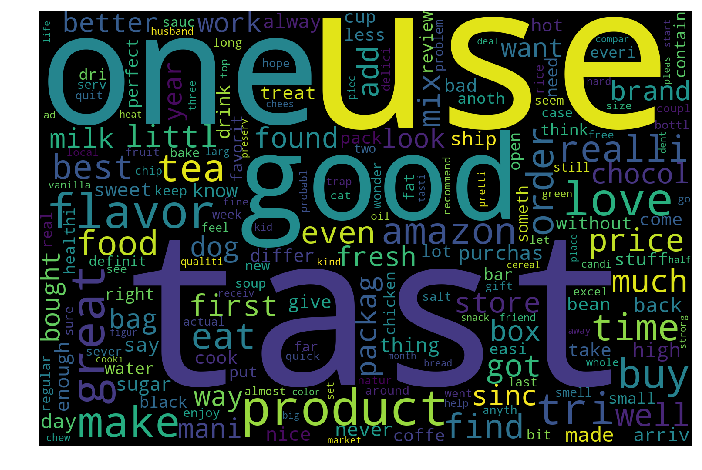

In [25]:
cloud(tfidf_DF,1)

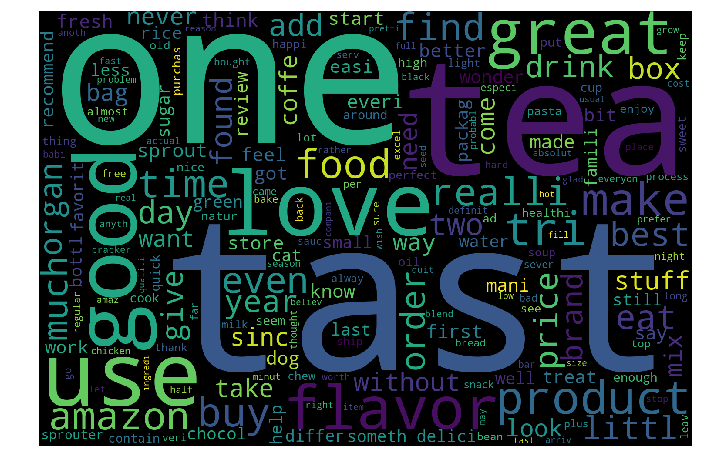

In [26]:
cloud(tfidf_DF,9)

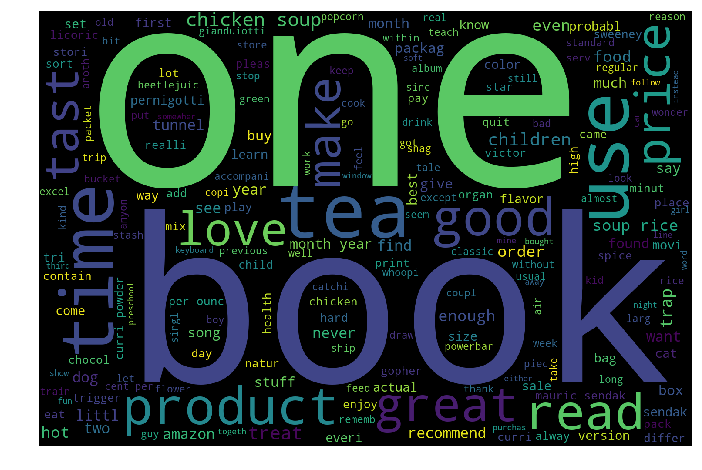

In [22]:
cloud(tfidf_DF,8)

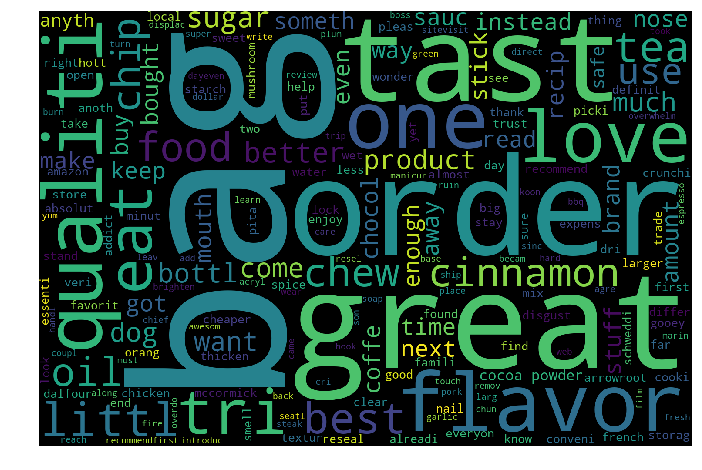

In [27]:
cloud(tfidf_DF,12)

<b> Observations : </b>

Below are some of the observations from the clusters formed,

Cluster 8 - Book

Cluster 12 - Bag.

and the other clusters seem to be expressing the most frequently used words lik taste, one great etc.



# <center>  -- Hierarchical clustering - AGGLOMERATIVE --

In [64]:
tfidf=TfidfVectorizer(min_df=3,dtype='float')
tfidf_train=tfidf.fit_transform(sorted_data['New'][:5000])
tfidf_train.shape

(5000, 4642)

#### 2 Clusters:

In [67]:
model=AgglomerativeClustering(n_clusters=2)

In [68]:
model.fit(tfidf_train.todense())

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='ward', memory=None, n_clusters=2,
            pooling_func=<function mean at 0x0000022337CAA378>)

In [69]:
lb=model.labels_
pd.value_counts(lb)

0    4518
1     482
dtype: int64

In [78]:
model2=AgglomerativeClustering(n_clusters=2,linkage='average')

In [79]:
model2.fit(tfidf_train.todense())

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='average', memory=None,
            n_clusters=2,
            pooling_func=<function mean at 0x0000022337CAA378>)

In [80]:
lb2=model2.labels_
pd.value_counts(lb2)

0    4989
1      11
dtype: int64

In [72]:
model1=AgglomerativeClustering(n_clusters=2,linkage='complete')

In [81]:
model1.fit(tfidf_train.todense())

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='complete', memory=None,
            n_clusters=2,
            pooling_func=<function mean at 0x0000022337CAA378>)

In [83]:
lb1=model1.labels_
pd.value_counts(lb1)

0    3208
1    1792
dtype: int64

Frmo above 3 different types of linkages, we can see that complete leakage seems to be having 2 big clusters.

In [84]:
tmp=sorted_data['New'][:5000]
tmp=pd.DataFrame(tmp)
tmp['Cluster']=lb1
tmp.Cluster.value_counts()

0    3208
1    1792
Name: Cluster, dtype: int64

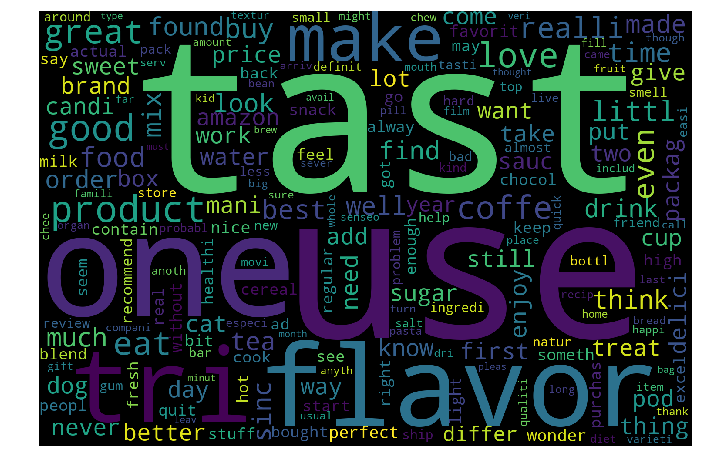

In [85]:
cloud(tmp,0)

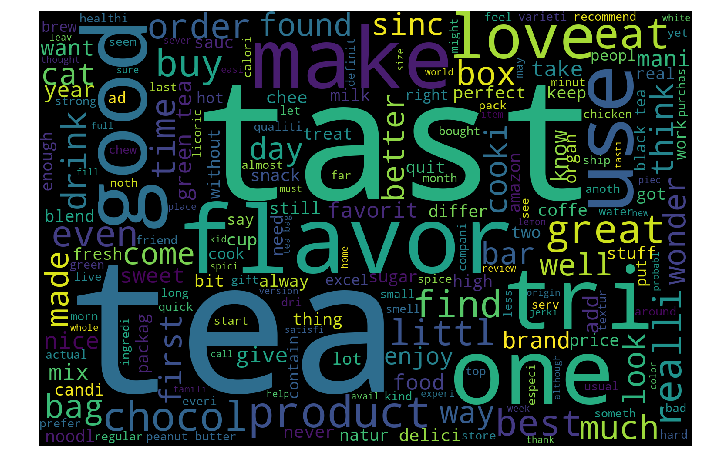

In [86]:
cloud(tmp,1)

<b> Observations : </b>

With just 2 clusters created, almost both the clusters had similarly used words.


#### 8 Clusters:

In [87]:
model=AgglomerativeClustering(n_clusters=8,linkage='complete')

In [88]:
model.fit(tfidf_train.todense())

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='complete', memory=None,
            n_clusters=8,
            pooling_func=<function mean at 0x0000022337CAA378>)

In [91]:
lb=model.labels_
pd.value_counts(lb)

0    1810
1    1155
3     826
2     773
4     148
5     143
6      95
7      50
dtype: int64

In [90]:
tmp=sorted_data['New'][:5000]
tmp=pd.DataFrame(tmp)
tmp['Cluster']=lb
tmp.Cluster.value_counts()

0    1810
1    1155
3     826
2     773
4     148
5     143
6      95
7      50
Name: Cluster, dtype: int64

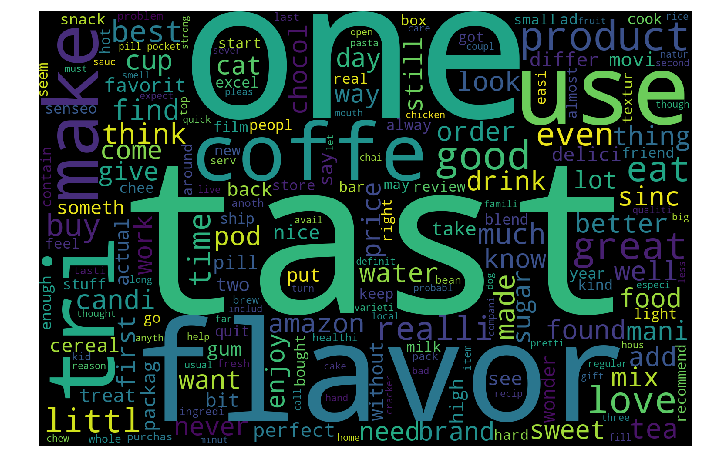

In [92]:
cloud(tmp,0)

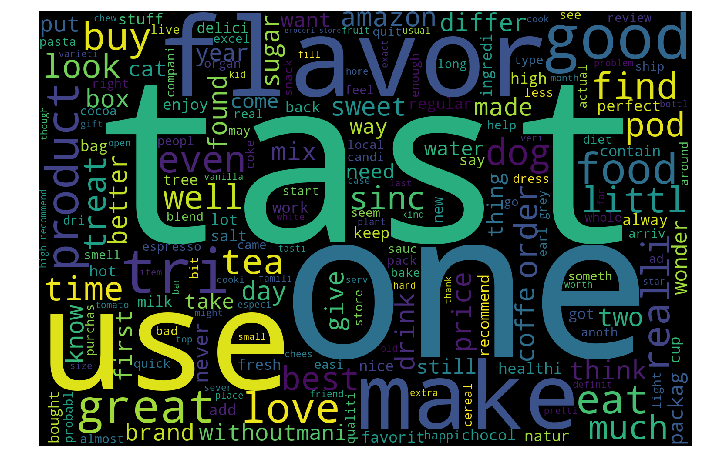

In [93]:
cloud(tmp,1)

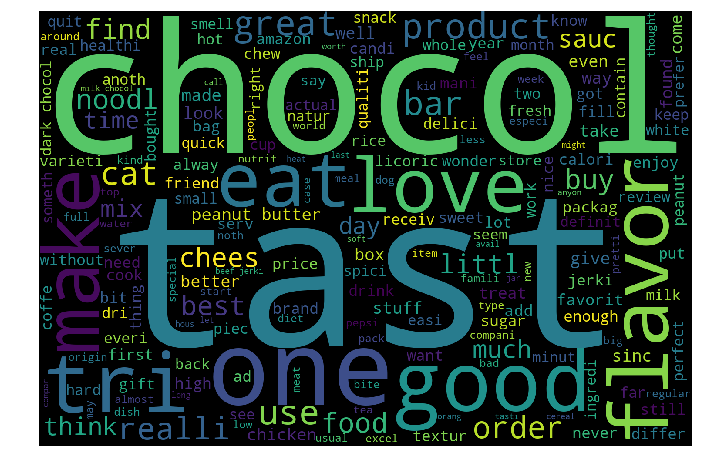

In [94]:
cloud(tmp,3)

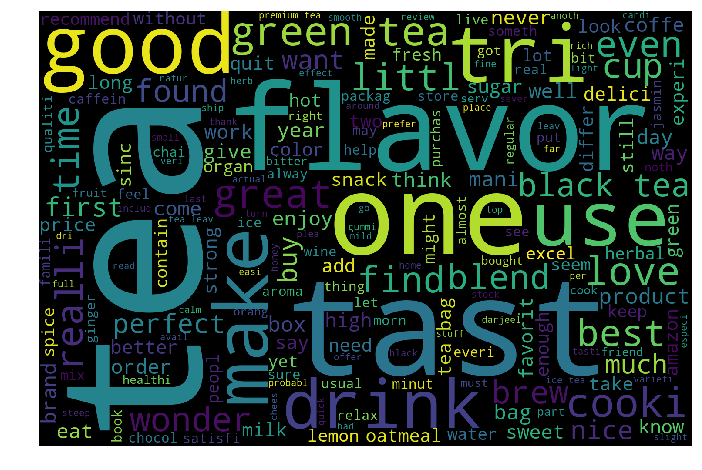

In [95]:
cloud(tmp,2)

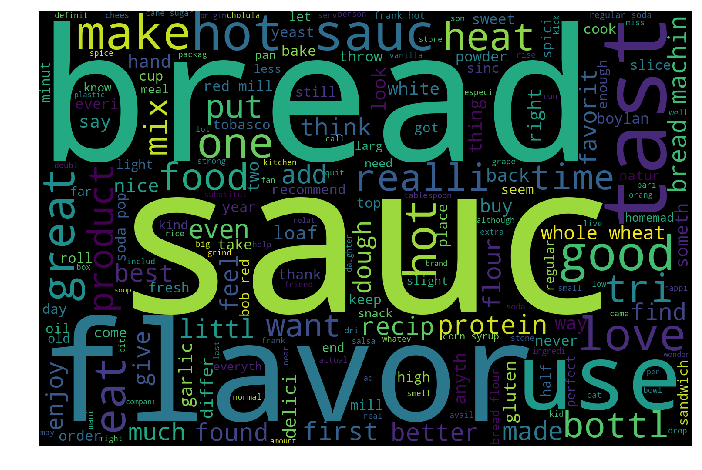

In [96]:
cloud(tmp,4)

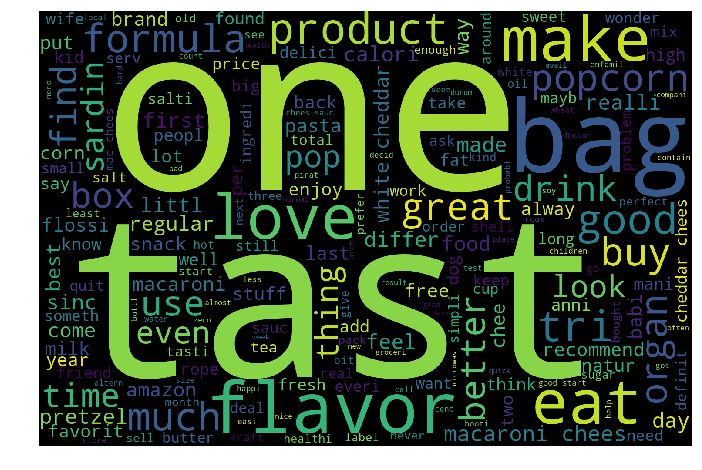

In [97]:
cloud(tmp,5)

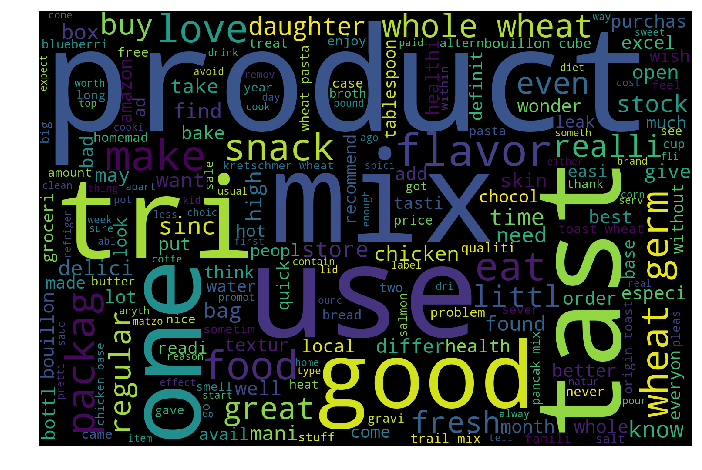

In [98]:
cloud(tmp,6)

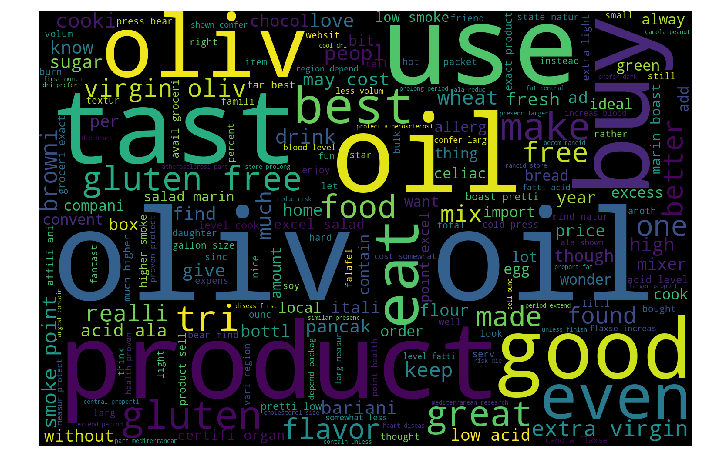

In [99]:
cloud(tmp,7)

<b> Observations : </b>

Below are some of the observations from the clusters formed,

Cluster 3 - Chocolate

Cluster 2 - Tea.

Cluster 4 - Bread

Cluster 7 - Olive oil.

and the other clusters seem to be expressing the most frequently used words like taste, one great etc.



#### 15 Clusters:

In [100]:
model=AgglomerativeClustering(n_clusters=15,linkage='complete')

In [101]:
model.fit(tfidf_train.todense())

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='complete', memory=None,
            n_clusters=15,
            pooling_func=<function mean at 0x0000022337CAA378>)

In [102]:
lb=model.labels_
pd.value_counts(lb)

3     1427
0     1114
2      774
1      620
12     257
4      148
5      143
13      95
6       90
14      79
9       63
11      52
7       50
8       47
10      41
dtype: int64

In [103]:
tmp=sorted_data['New'][:5000]
tmp=pd.DataFrame(tmp)
tmp['Cluster']=lb
tmp.Cluster.value_counts()

3     1427
0     1114
2      774
1      620
12     257
4      148
5      143
13      95
6       90
14      79
9       63
11      52
7       50
8       47
10      41
Name: Cluster, dtype: int64

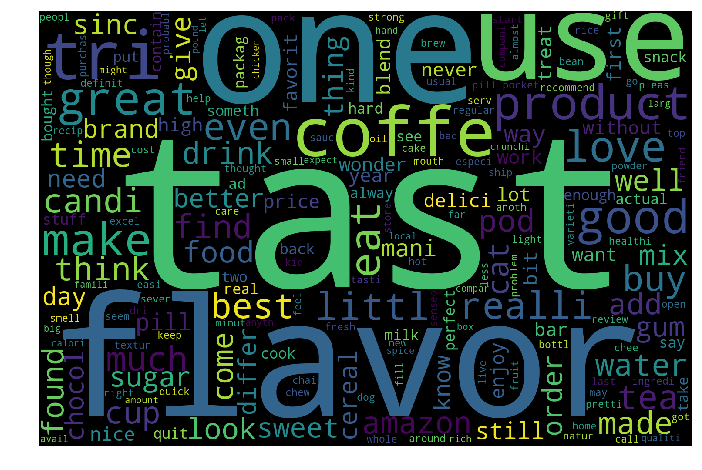

In [104]:
cloud(tmp,3)

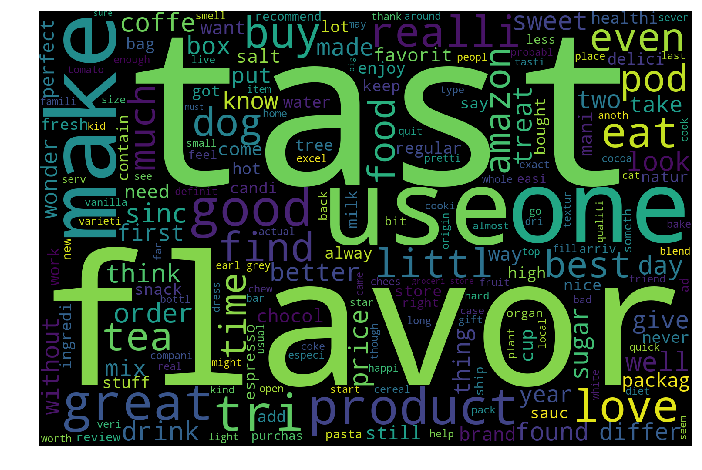

In [105]:
cloud(tmp,0)

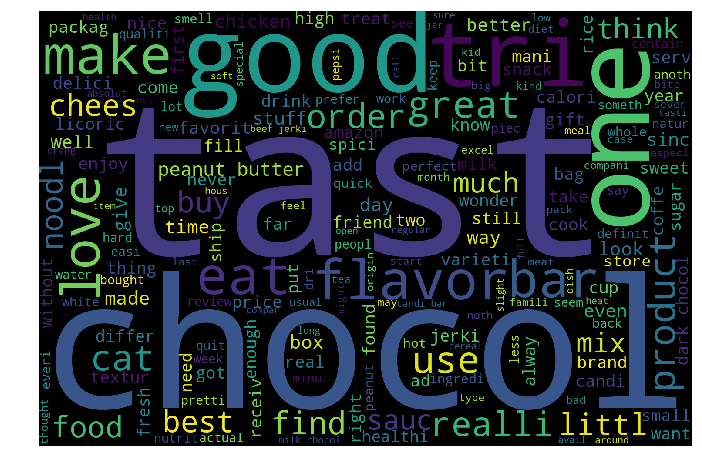

In [106]:
cloud(tmp,2)

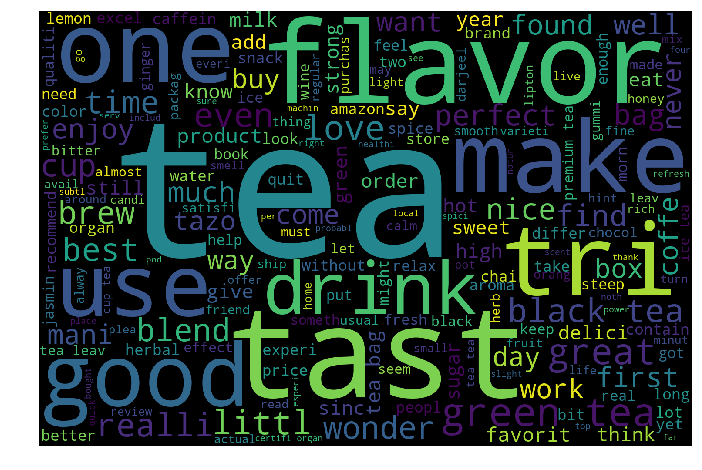

In [107]:
cloud(tmp,1)

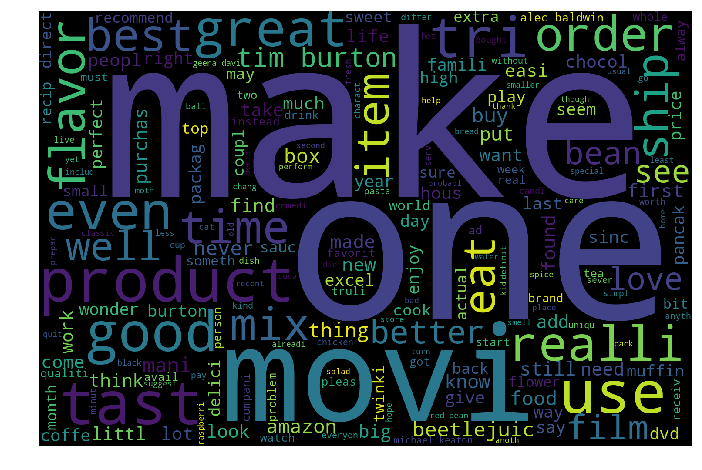

In [108]:
cloud(tmp,12)

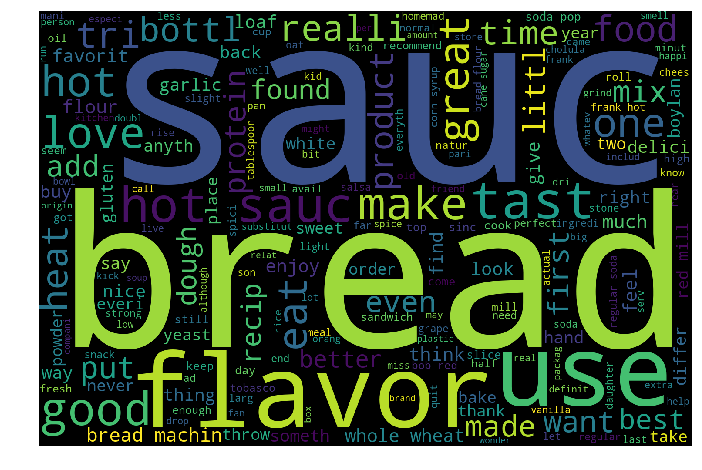

In [109]:
cloud(tmp,4)

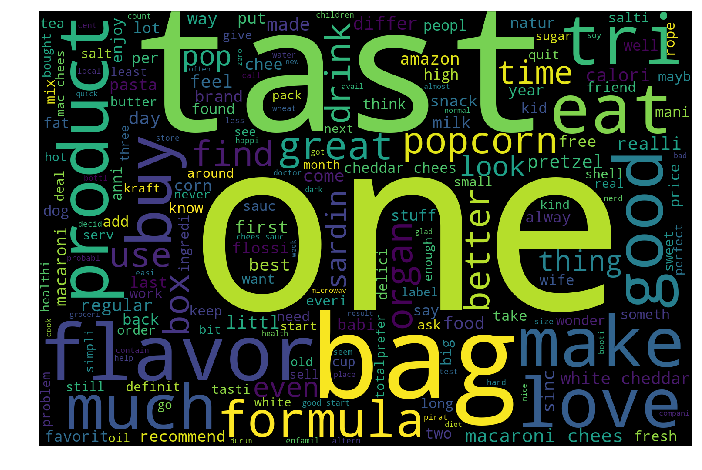

In [110]:
cloud(tmp,5)

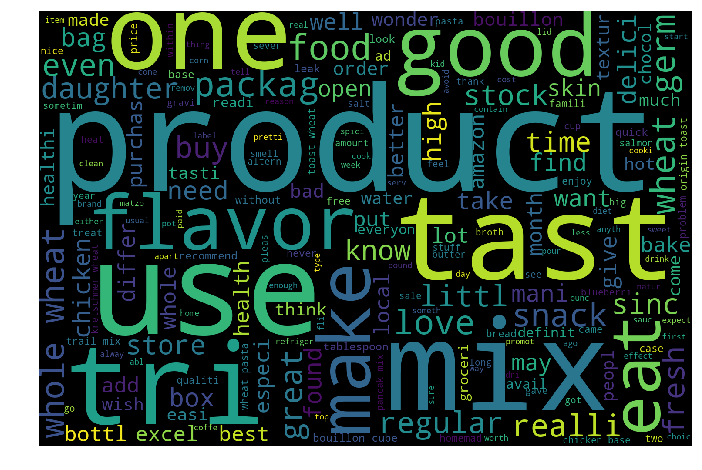

In [111]:
cloud(tmp,13)

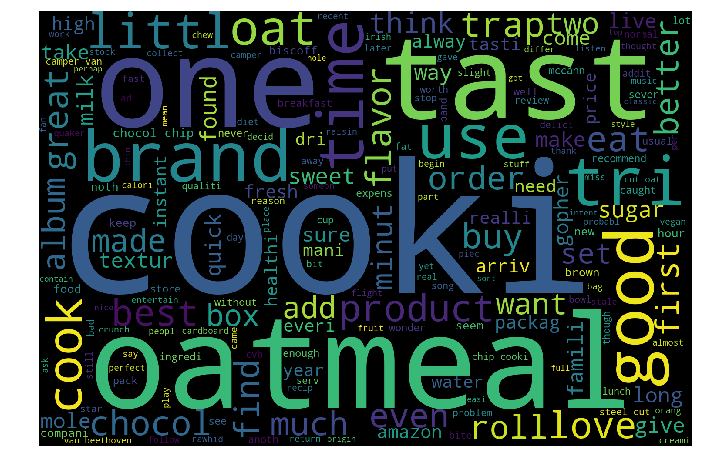

In [112]:
cloud(tmp,6)

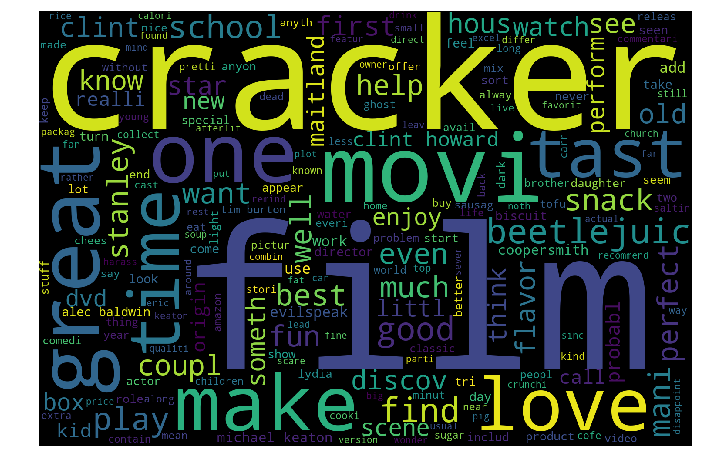

In [113]:
cloud(tmp,14)

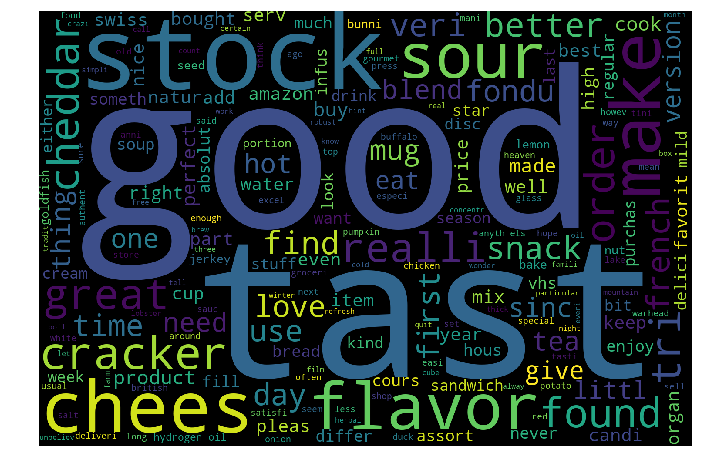

In [114]:
cloud(tmp,9)

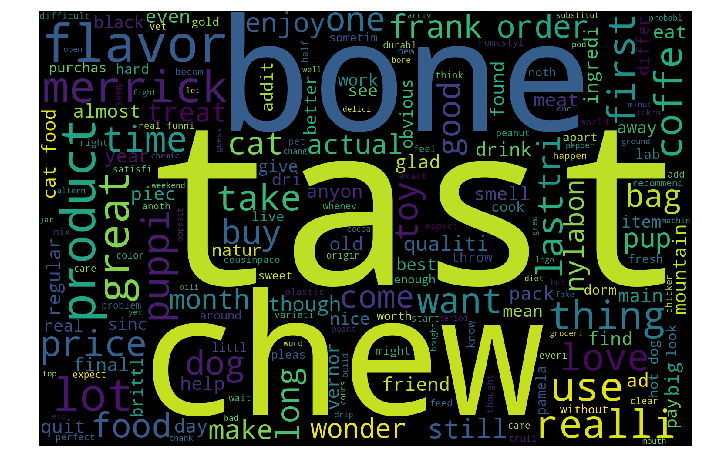

In [115]:
cloud(tmp,11)

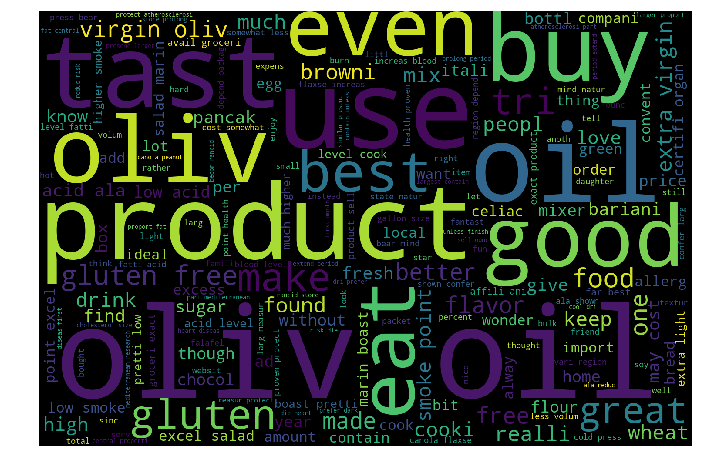

In [116]:
cloud(tmp,7)

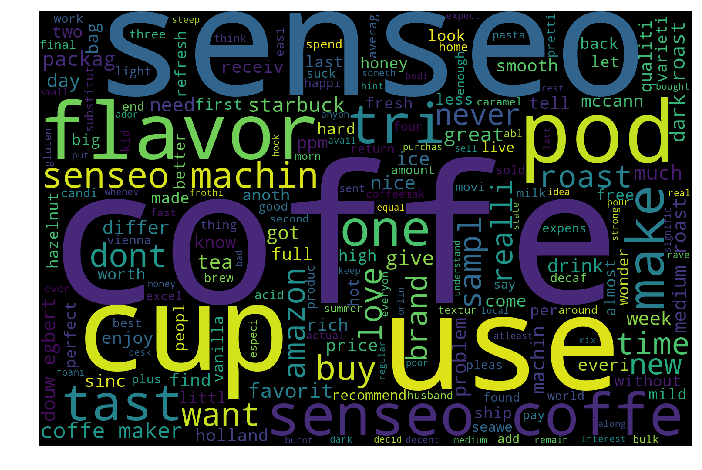

In [117]:
cloud(tmp,8)

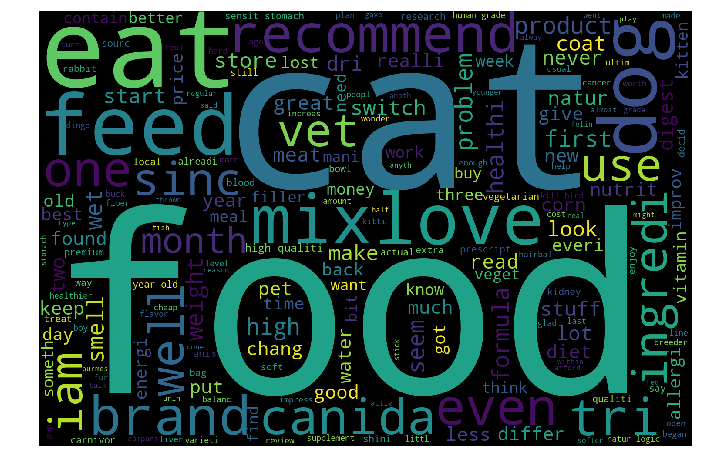

In [118]:
cloud(tmp,10)

<b> Observations : </b>

Below are some of the observations from the clusters formed,

Cluster 12 - Making and about movies.

Cluster 1 - Tea.

Cluster 4 - Sauce & Bread

Cluster 6 - Cooking.

Cluster 14 - Crackers and films.

Cluster 11- Bone and chewing.

Cluster 8 - Coffee.

Cluster 10 - Cat


and the other clusters seem to be expressing the most frequently used words like taste, one great etc.



# <center>  -- DBSCAN  --

In [16]:
scaler=StandardScaler(with_mean=False)
std_tfidf_train=scaler.fit_transform(tfidf_train)

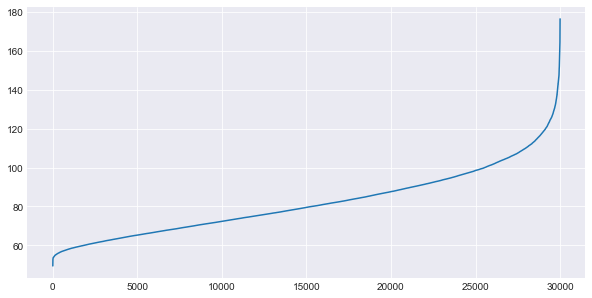

In [17]:
eps_elbow(std_tfidf_train[:30000],8000)

In [ ]:
model=DBSCAN(eps=120,min_samples=7500)

In [23]:
model.fit(std_tfidf_train)

DBSCAN(algorithm='auto', eps=120, leaf_size=30, metric='euclidean',
    metric_params=None, min_samples=7500, n_jobs=None, p=None)

In [24]:
lb=model.labels_
pd.value_counts(lb)

 0    29878
-1      122
dtype: int64

In [26]:
tmp=sorted_data['New'][:30000]
tmp=pd.DataFrame(tmp)
tmp['Cluster']=lb
tmp.Cluster.value_counts()

 0    29878
-1      122
Name: Cluster, dtype: int64

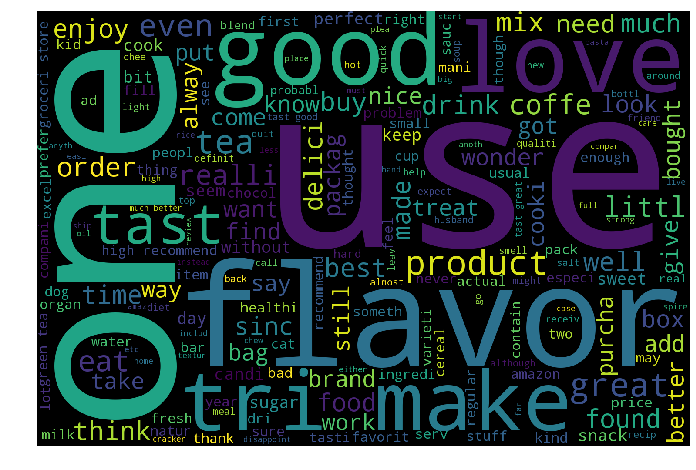

In [27]:
cloud(tmp,0)

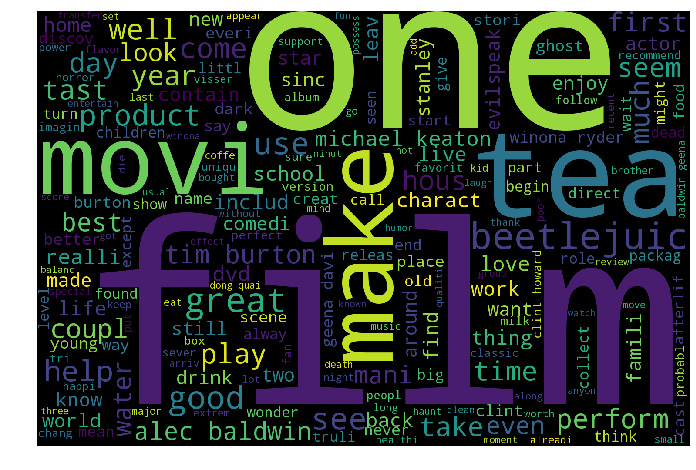

In [28]:
cloud(tmp,-1)

<b> Observations : </b>

Similar to BOW, DBSCAN just detects 2 clusters one with all the overlapped points and the other with just Outliers.



# <center><font size="+3.5"> Building W2V Model

In [42]:
from gensim.models import Word2Vec

In [43]:
#Creating sentence list

sentence_list=[]
for sentence in train['New']:
    sentence_list.append(sentence.split())

#sentence_list[5]


In [44]:
w2v=Word2Vec(sentence_list,size=200,min_count=1,workers=4)

In [45]:
w2v_list=list(w2v.wv.vocab)

In [26]:
len(w2v_list)

55208

# <center><font size="+4.5"> (iii) Average W2V Vectorization:

In [29]:
def avgwv(x):
    '''
    To calculate average word 2 vector model
    '''
    sent_vect=[]
    for sentence in x:
        count=0;
        s_v=np.zeros(200)
        for words in sentence.split():
            if words in w2v_list:
                V=w2v.wv[words]
                count+=1
                s_v+=V
            if (count!=0):
                s_v/=count
        sent_vect.append(s_v)
    return(sent_vect)
                    

In [30]:
train_w2v=avgwv(train['New'])

In [31]:
test_w2v=avgwv(test['New'])

In [13]:
with open(r'G:\ML\Pickles\Avgw2v_200d.pickle','rb') as f:
    train_w2v,test_w2v=pickle.load(f)

# <center>  K Means clustering

### Finding optimal value of K :


 For K value =5 and inertia is 21279592.22171253

 For K value =10 and inertia is 19526999.749408532

 For K value =20 and inertia is 17543843.657602407

 For K value =50 and inertia is 14599567.12510605

 For K value =70 and inertia is 13462763.824986568

 For K value =90 and inertia is 12453646.95221115

 For K value =120 and inertia is 11295690.914057504

 For K value =150 and inertia is 10419658.443172952

 For K value =200 and inertia is 9228601.62808219


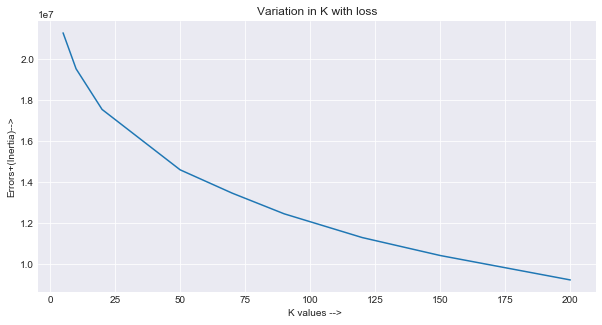

In [30]:
optimal_k(std_train_avgw2v[:100000])

Noticeable inflection occurs at k = 20.

### Implementation:

In [32]:
model=KMeans(n_clusters=20,init='k-means++',n_init=10,random_state=33)

In [42]:
model.fit(std_train_avgw2v[:100000])

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=20, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=33, tol=0.0001, verbose=0)

In [43]:
lb=model.labels_
pd.value_counts(lb)

18    59347
1     11097
6      4051
8      3226
0      2360
19     2284
14     2150
7      1989
13     1814
12     1641
11     1553
17     1396
16     1381
10     1264
9      1117
3       892
2       723
15      683
4       619
5       413
dtype: int64

In [47]:
avgw2v_DF= pd.DataFrame(sorted_data['New'][:100000])
avgw2v_DF['Cluster']=pd.Series(lb)
avgw2v_DF.head()

,New,Cluster
0,witti littl book make son laugh loud recit car...,18.0
30,rememb see show air televis year child sister ...,18.0
424,beetlejuic well written movi everyth excel act...,11.0
330,twist rumplestiskin captur star michael keaton...,18.0
423,beetlejuic excel funni movi keaton hilari wack...,18.0


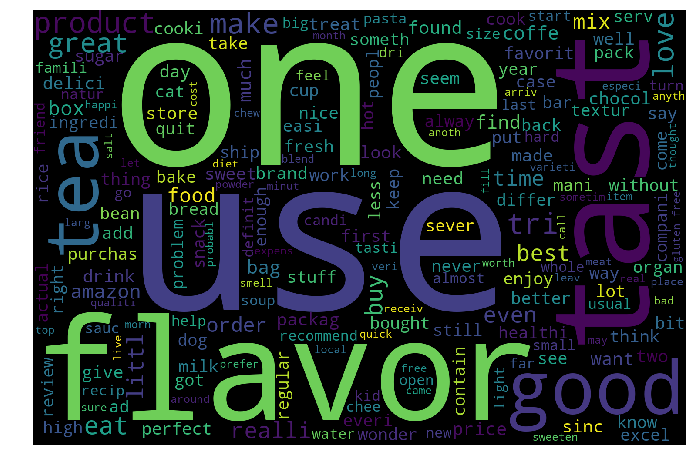

In [50]:
cloud(avgw2v_DF,6)

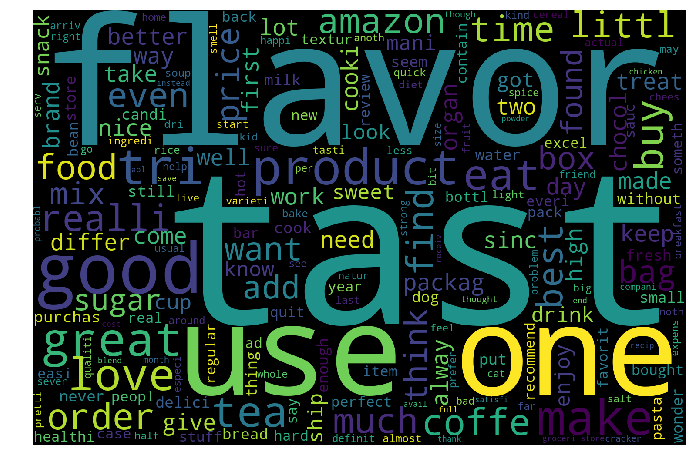

In [51]:
cloud(avgw2v_DF,8)

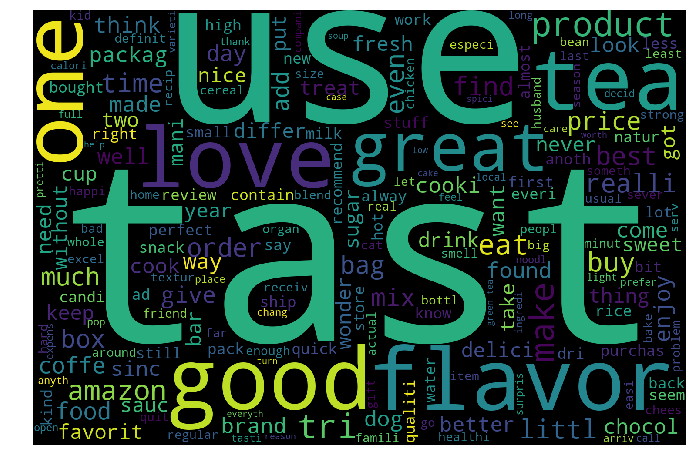

In [52]:
cloud(avgw2v_DF,0)

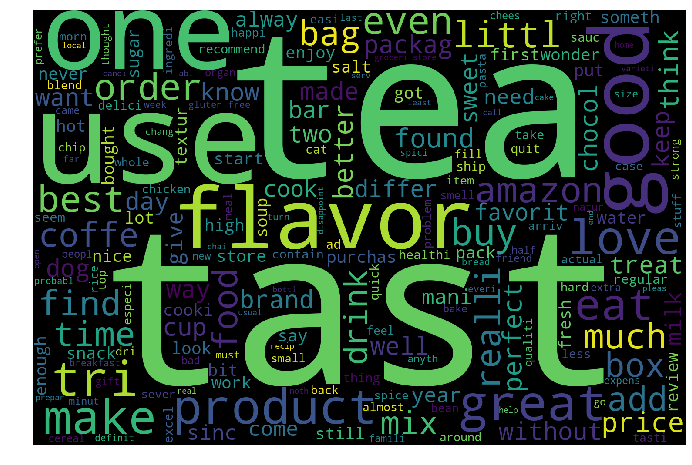

In [53]:
cloud(avgw2v_DF,19)

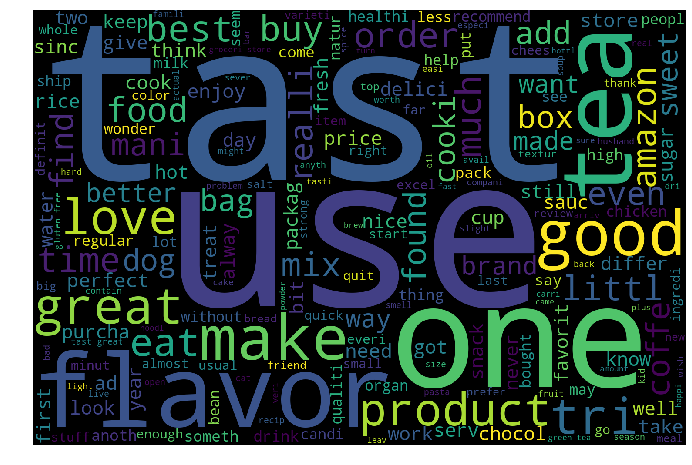

In [54]:
cloud(avgw2v_DF,14)

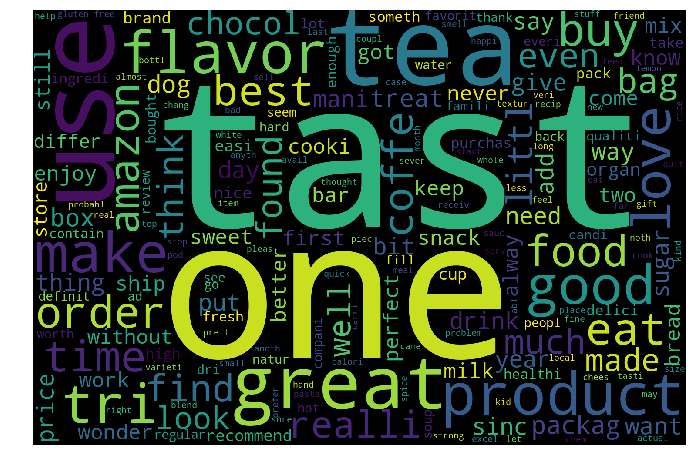

In [55]:
cloud(avgw2v_DF,7)

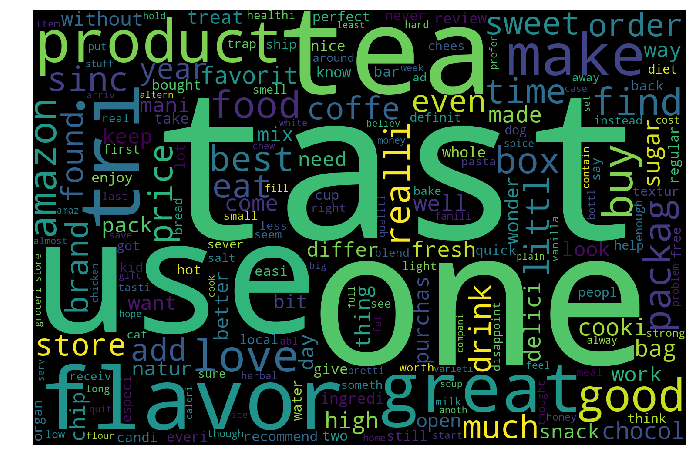

In [56]:
cloud(avgw2v_DF,3)

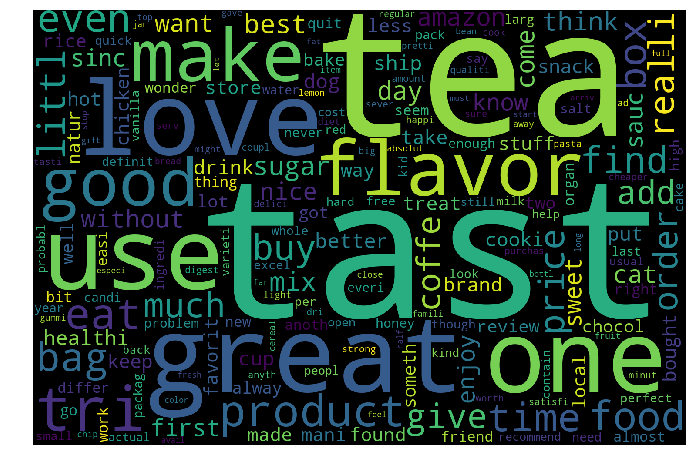

In [57]:
cloud(avgw2v_DF,2)

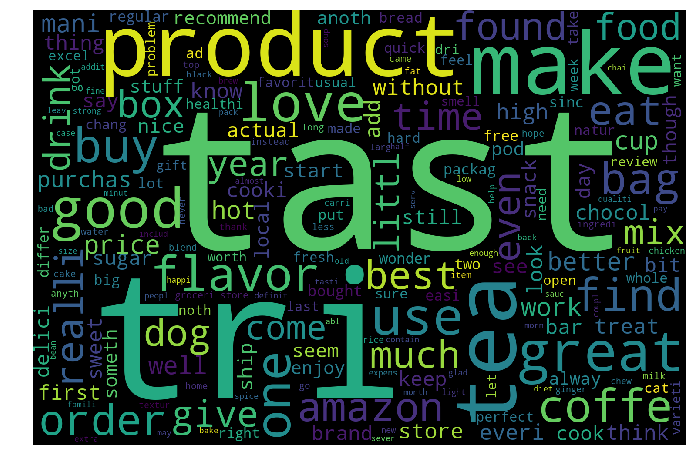

In [58]:
cloud(avgw2v_DF,15)

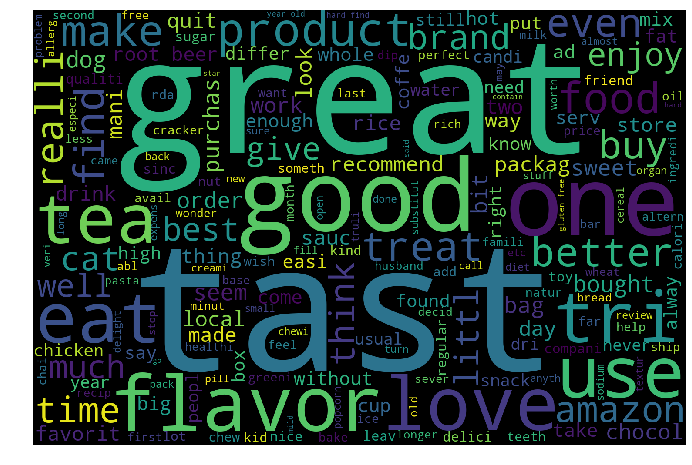

In [49]:
cloud(avgw2v_DF,5)

<b> Observations : </b>

Almost of the clusters formed were having similar terms like taste,one,flavour, good etc used. This tells that the Kmeans clustering is not that good with word2vec models.


# <center>  -- Hierarchical clustering - AGGLOMERATIVE --

#### 2 Clusters:

In [12]:
model=AgglomerativeClustering(n_clusters=2)

In [13]:
model.fit(std_train_avgw2v[:5000])

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='ward', memory=None, n_clusters=2,
            pooling_func=<function mean at 0x000002763A59B378>)

In [14]:
lb=model.labels_
pd.value_counts(lb)

0    4999
1       1
dtype: int64

In [15]:
model2=AgglomerativeClustering(n_clusters=2,linkage='average')

In [16]:
model2.fit(std_train_avgw2v[:5000])

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='average', memory=None,
            n_clusters=2,
            pooling_func=<function mean at 0x000002763A59B378>)

In [17]:
lb2=model2.labels_
pd.value_counts(lb2)

0    4999
1       1
dtype: int64

In [18]:
model1=AgglomerativeClustering(n_clusters=2,linkage='complete')

In [19]:
model1.fit(std_train_avgw2v[:5000])

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='complete', memory=None,
            n_clusters=2,
            pooling_func=<function mean at 0x000002763A59B378>)

In [20]:
lb1=model1.labels_
pd.value_counts(lb1)

0    4999
1       1
dtype: int64

With all 3 popular linkages, we are not able to cluster properly. Lets try with increasing the number of clusters.

In [51]:
model1=AgglomerativeClustering(n_clusters=5,linkage='complete')

In [52]:
model1.fit(std_train_avgw2v[:5000])

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='complete', memory=None,
            n_clusters=5,
            pooling_func=<function mean at 0x000002763A59B378>)

In [53]:
lb1=model1.labels_
pd.value_counts(lb1)

0    4996
3       1
2       1
1       1
4       1
dtype: int64

#### 10 Clusters:

In [54]:
model1=AgglomerativeClustering(n_clusters=10,linkage='complete')

In [55]:
model1.fit(std_train_avgw2v[:5000])

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='complete', memory=None,
            n_clusters=10,
            pooling_func=<function mean at 0x000002763A59B378>)

In [56]:
lb1=model1.labels_
pd.value_counts(lb1)

2    4970
1      15
0       7
4       2
7       1
3       1
6       1
9       1
5       1
8       1
dtype: int64

In [57]:
tmp=sorted_data['New'][:5000]
tmp=pd.DataFrame(tmp)
tmp['Cluster']=lb1

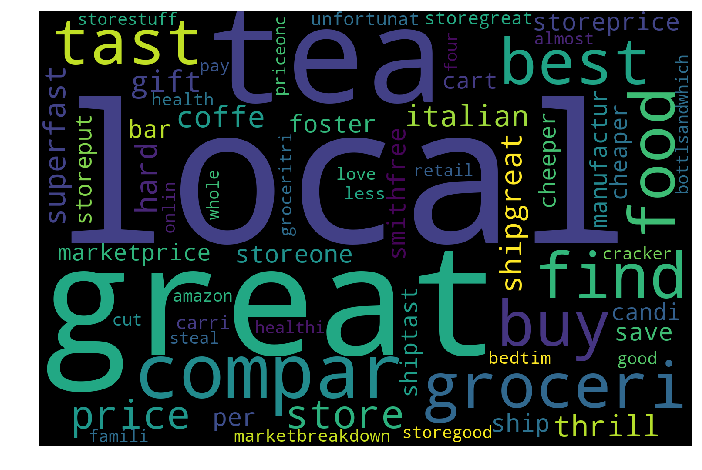

In [58]:
cloud(tmp,1)

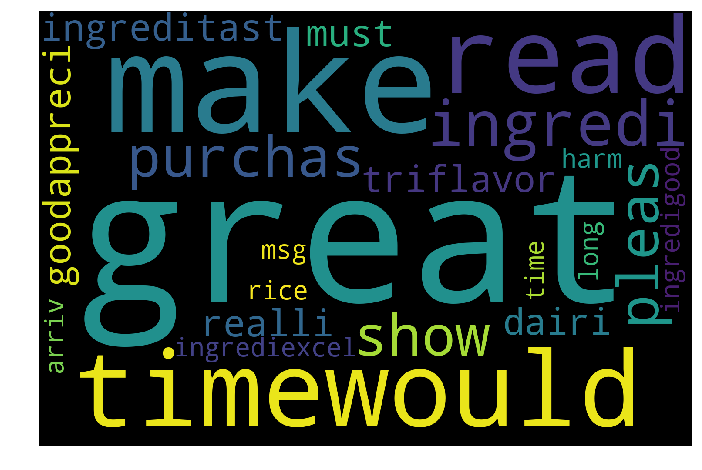

In [59]:
cloud(tmp,0)

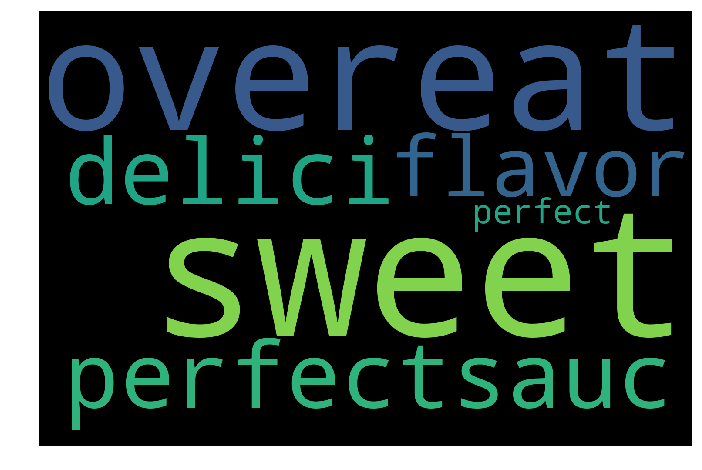

In [60]:
cloud(tmp,4)

#### 20 Clusters:

In [30]:
model1=AgglomerativeClustering(n_clusters=20,linkage='complete')

In [31]:
model1.fit(std_train_avgw2v[:5000])

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='complete', memory=None,
            n_clusters=20,
            pooling_func=<function mean at 0x000002763A59B378>)

In [32]:
lb1=model1.labels_
pd.value_counts(lb1)

2     4958
0       13
3        5
6        3
9        2
4        2
7        2
8        2
1        2
12       1
16       1
5        1
19       1
13       1
15       1
10       1
14       1
18       1
11       1
17       1
dtype: int64

In [33]:
tmp=sorted_data['New'][:5000]
tmp=pd.DataFrame(tmp)
tmp['Cluster']=lb1
tmp.Cluster.value_counts()

2     4958
0       13
3        5
6        3
9        2
4        2
7        2
8        2
1        2
12       1
16       1
5        1
19       1
13       1
15       1
10       1
14       1
18       1
11       1
17       1
Name: Cluster, dtype: int64

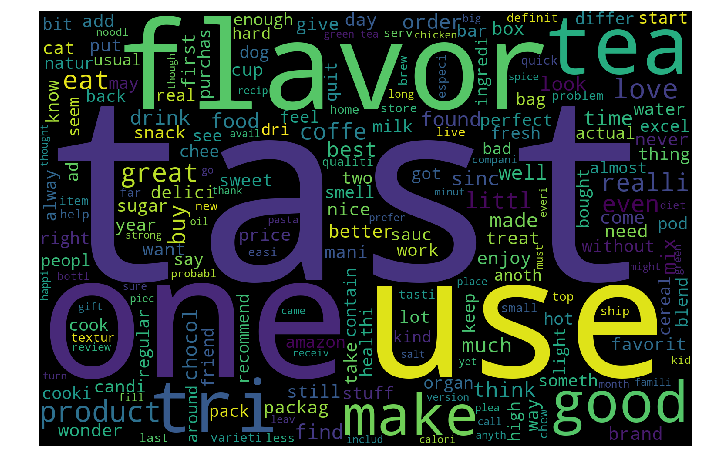

In [34]:
cloud(tmp,2)

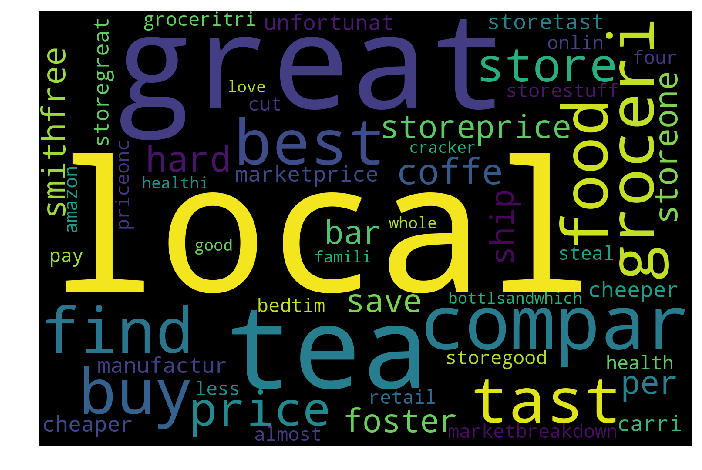

In [35]:
cloud(tmp,0)

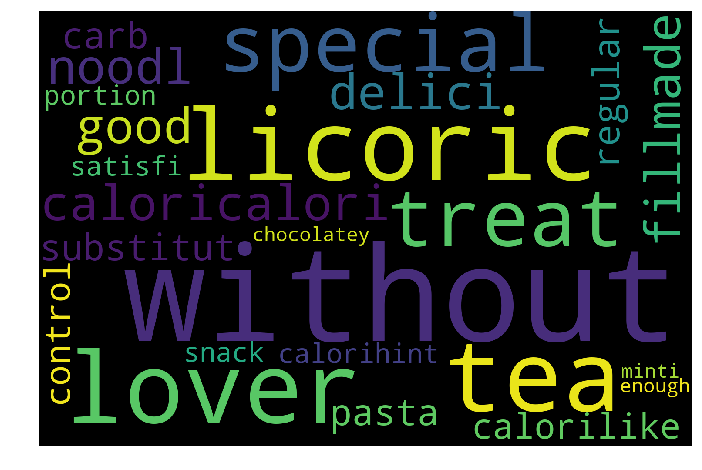

In [36]:
cloud(tmp,3)

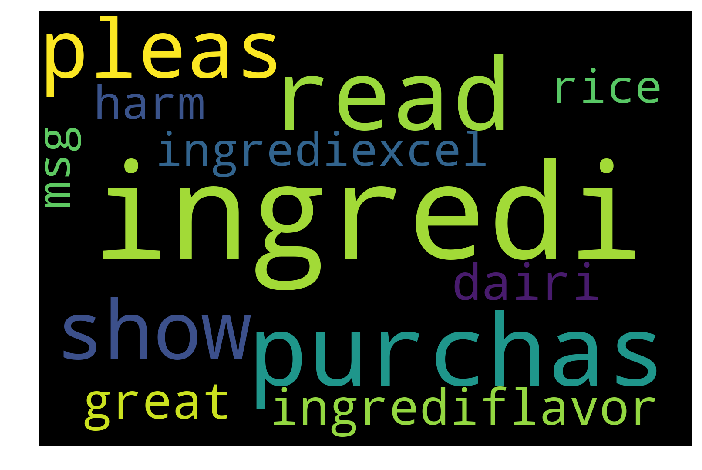

In [38]:
cloud(tmp,6)

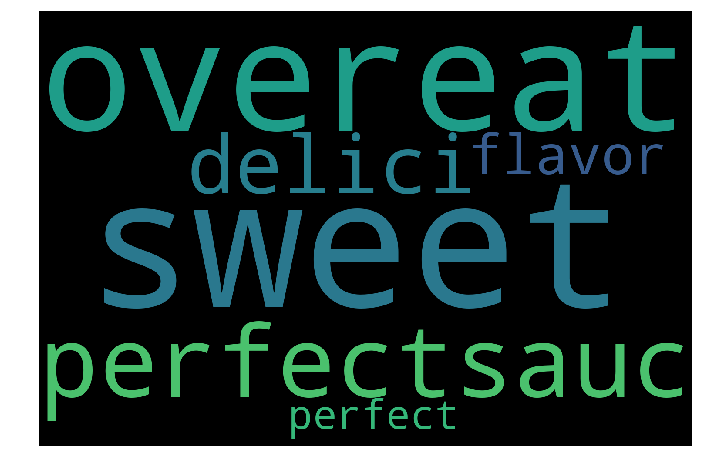

In [39]:
cloud(tmp,9)

<b> Observations : </b>

Below are some of the observations from the clusters formed,

Cluster 0 - Local is used more.

Cluster 3 - Licoric and calori are used more.

Cluster 9 - Overeating

Cluster 6 - Ingredients.


and the other clusters seem to be expressing the most frequently used words like taste, one great etc.



#### 30 Clusters:

In [40]:
model1=AgglomerativeClustering(n_clusters=30,linkage='complete')

In [41]:
model1.fit(std_train_avgw2v[:5000])

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='complete', memory=None,
            n_clusters=30,
            pooling_func=<function mean at 0x000002763A59B378>)

In [42]:
lb1=model1.labels_
pd.value_counts(lb1)

5     4750
6       81
2       46
0       44
13      22
12      14
1       10
4        4
28       3
10       2
9        2
26       2
3        2
7        2
24       1
16       1
8        1
20       1
27       1
17       1
21       1
23       1
29       1
14       1
18       1
22       1
11       1
15       1
19       1
25       1
dtype: int64

In [43]:
tmp=sorted_data['New'][:5000]
tmp=pd.DataFrame(tmp)
tmp['Cluster']=lb1
tmp.Cluster.value_counts()

5     4750
6       81
2       46
0       44
13      22
12      14
1       10
4        4
28       3
10       2
9        2
26       2
3        2
7        2
24       1
16       1
8        1
20       1
27       1
17       1
21       1
23       1
29       1
14       1
18       1
22       1
11       1
15       1
19       1
25       1
Name: Cluster, dtype: int64

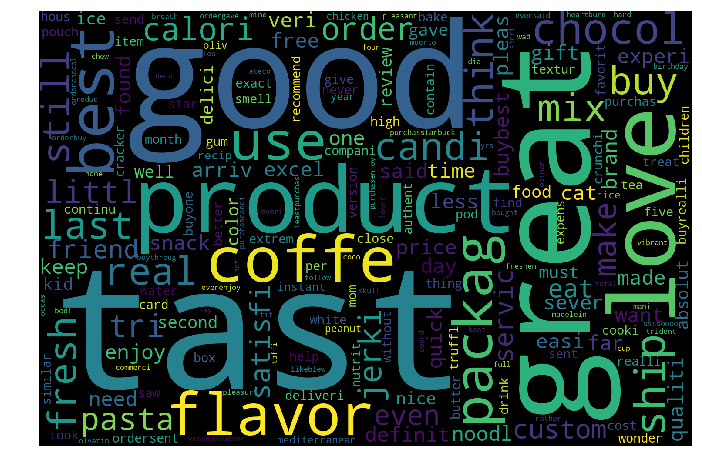

In [44]:
cloud(tmp,6)

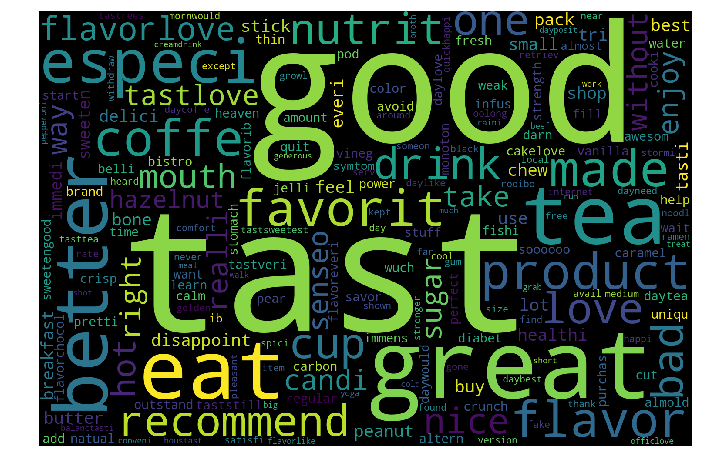

In [45]:
cloud(tmp,2)

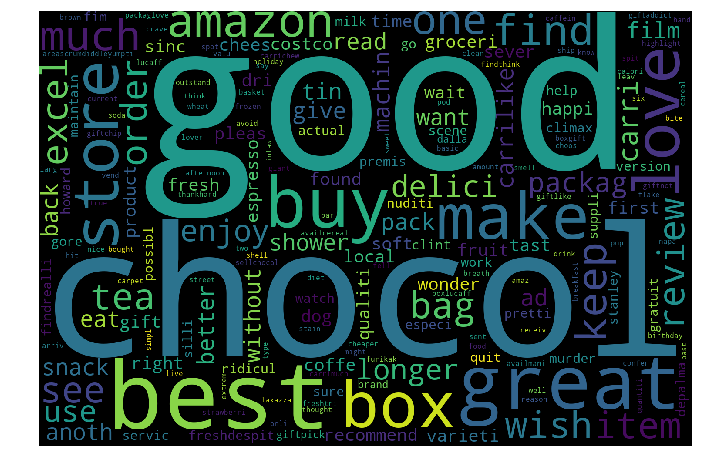

In [46]:
cloud(tmp,0)

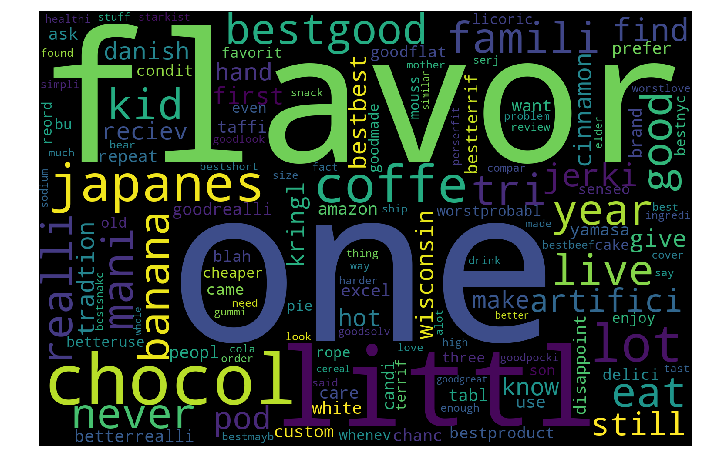

In [47]:
cloud(tmp,13)

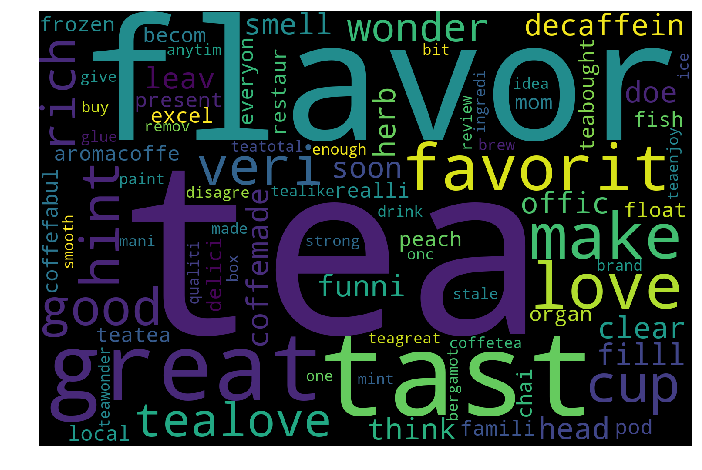

In [48]:
cloud(tmp,12)

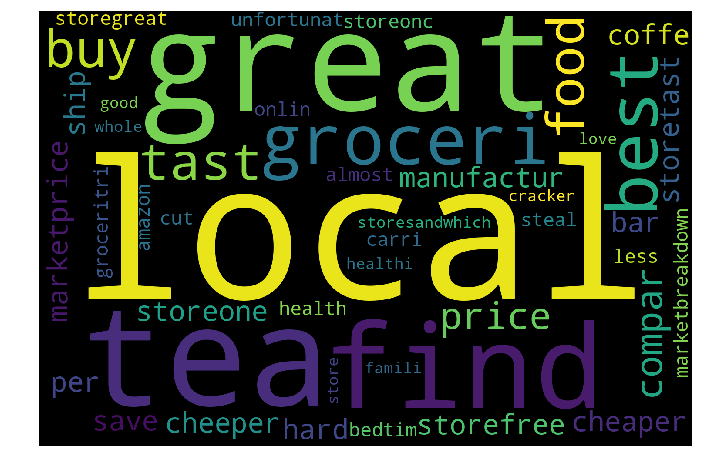

In [49]:
cloud(tmp,1)

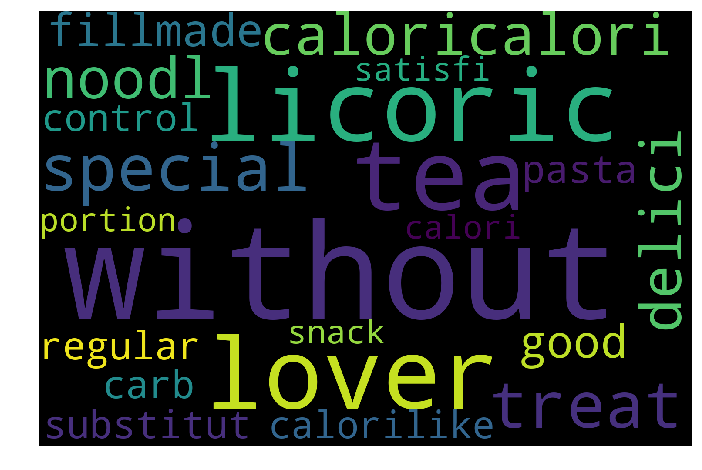

In [50]:
cloud(tmp,4)

<b> Observations : </b>

Below are some of the observations from the clusters formed,

Cluster 0 - Chocolate.

Cluster 48 - Tea.

Cluster 1 - Local, groceries.

Cluster 4 - Licoric & calories.


and the other clusters seem to be expressing the most frequently used words like taste, one great etc.



# <center>  -- DBSCAN  --

In [14]:
scaler=StandardScaler(with_mean=False)
std_train_avgw2v=scaler.fit_transform(train_w2v[:25000])

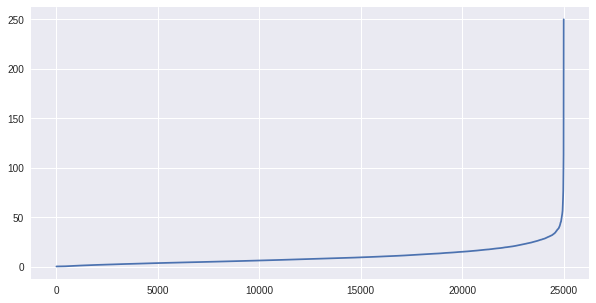

In [12]:
eps_elbow(std_train_avgw2v,400)

In [0]:
model=DBSCAN(eps=40,min_samples=400)

In [21]:
model.fit(std_train_avgw2v)

DBSCAN(algorithm='auto', eps=40, leaf_size=30, metric='euclidean',
    metric_params=None, min_samples=400, n_jobs=None, p=None)

In [22]:
lb=model.labels_
pd.value_counts(lb)

 0    24957
-1       43
dtype: int64

In [23]:
tmp=sorted_data['New'][:25000]
tmp=pd.DataFrame(tmp)
tmp['Cluster']=lb
tmp.Cluster.value_counts()

 0    24957
-1       43
Name: Cluster, dtype: int64

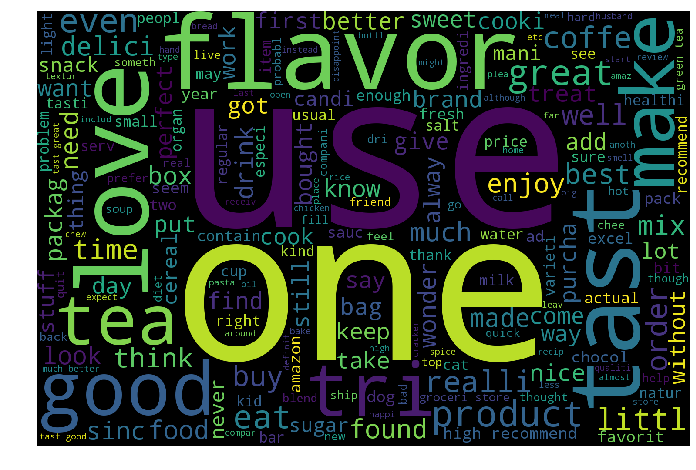

In [24]:
cloud(tmp,0)

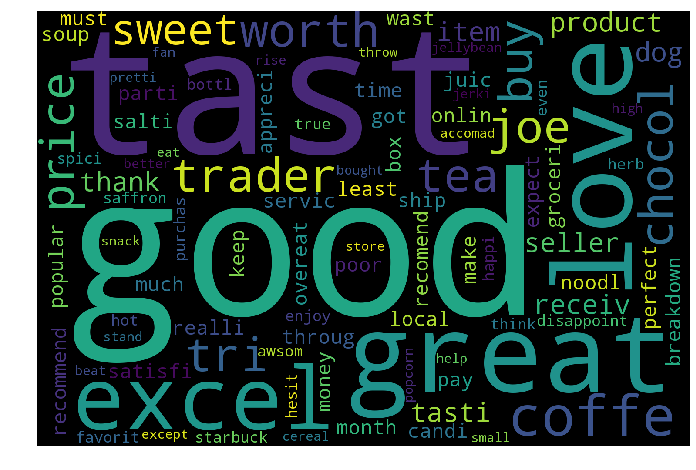

In [25]:
cloud(tmp,-1)

<b> Observations : </b>

As usual DBSCAN detected 2 clusters, one for the cluster points and the other for outlier points. 43 points were classified as outlier points.



# <center><font size="+4.5"> (iv) Tf-IDF W2V Vectorization:

In [37]:
dictionary = dict(zip(tfidf.get_feature_names(), list(tfidf.idf_)))

In [40]:
features=tfidf.get_feature_names()

def tfidf_w2v(x):
    '''
    To calculate Tf-IDf weighted word2vec for a review
    '''     
    row=0
    sentence_vectors=[]
    for sentences in x:
        weight=0
        s_v=np.zeros(200)
        for words in sentences.split():
            if words in w2v_list:
                try:
                    v=w2v.wv[words]
                    #tfidf_value=y[row,features.index(words)]
                    tfidf_value = dictionary[words]*sentences.count(words)
                    s_v+=(v*tfidf_value)
                    weight+=tfidf_value
                except(KeyError):
                    continue                
            else:
                continue
        if(weight!=0):
            s_v/=weight
        sentence_vectors.append(s_v)
        row+=1
    return sentence_vectors
                
    
    

In [16]:
with open(r'G:\ML\Pickles\tfidfw2v_train_200d.pickle','rb') as f:
    train_tfidf_w2v=pickle.load(f)

In [35]:
with open(r'G:\ML\Pickles\tfidfw2v_test_200d.pickle','rb') as f:
    test_tfidf_w2v=pickle.load(f)

# <center>  K Means clustering

### Finding optimal value of K :


 For K value =5 and inertia is 16531257.978075814

 For K value =10 and inertia is 14900383.461427866

 For K value =20 and inertia is 13629950.256880268

 For K value =50 and inertia is 11816160.459727911

 For K value =70 and inertia is 11190869.97125564

 For K value =90 and inertia is 10731200.216176625

 For K value =120 and inertia is 10261227.672995277

 For K value =150 and inertia is 9905603.65824991

 For K value =200 and inertia is 9475534.67783844


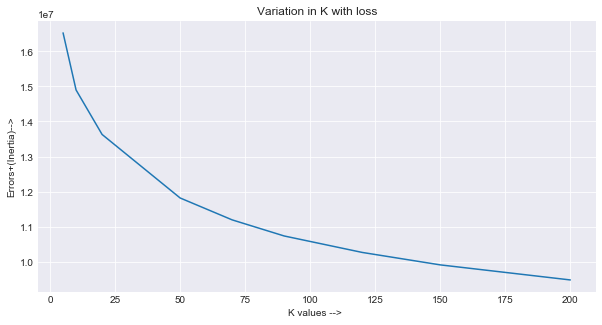

In [37]:
optimal_k(std_train_tfidfw2v[:100000])

Inflection point occured at around k = 20.

### Implementation:

In [69]:
tfidf_w2v_model=KMeans(n_clusters=20,init='k-means++',n_init=10,random_state=33)

In [70]:
tfidf_w2v_model.fit(std_train_tfidfw2v[:100000])

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=20, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=33, tol=0.0001, verbose=0)

In [82]:
lb=tfidf_w2v_model.labels_
pd.value_counts(lb)

8     10172
17     8988
0      7135
9      6634
4      6596
6      6455
16     6413
15     5496
1      5017
5      4880
18     4641
19     4229
12     3882
11     3833
13     3473
10     3007
3      2583
7      2284
14     2276
2      2006
dtype: int64

In [85]:
tfidfw2v_DF=pd.DataFrame(sorted_data['New'][:100000])
tfidfw2v_DF['Cluster']=pd.Series(lb)
tfidfw2v_DF.head()

,New,Cluster
0,witti littl book make son laugh loud recit car...,8.0
30,rememb see show air televis year child sister ...,8.0
424,beetlejuic well written movi everyth excel act...,17.0
330,twist rumplestiskin captur star michael keaton...,13.0
423,beetlejuic excel funni movi keaton hilari wack...,15.0


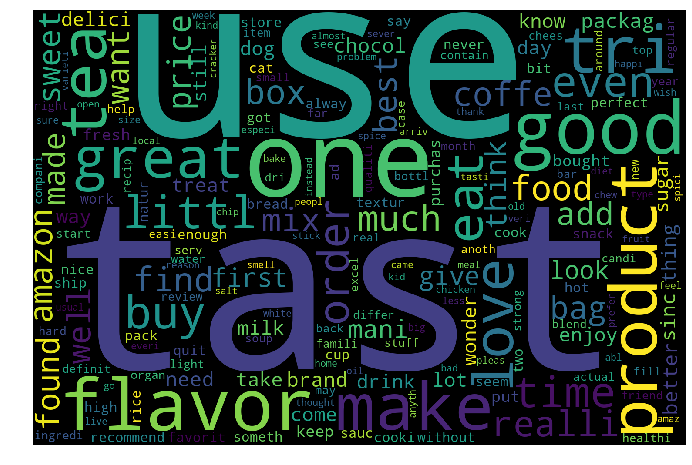

In [87]:
cloud(tfidfw2v_DF,1)

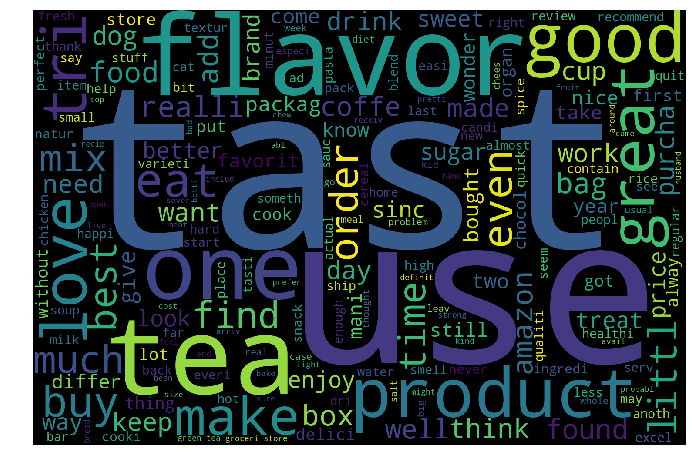

In [88]:
cloud(tfidfw2v_DF,5)

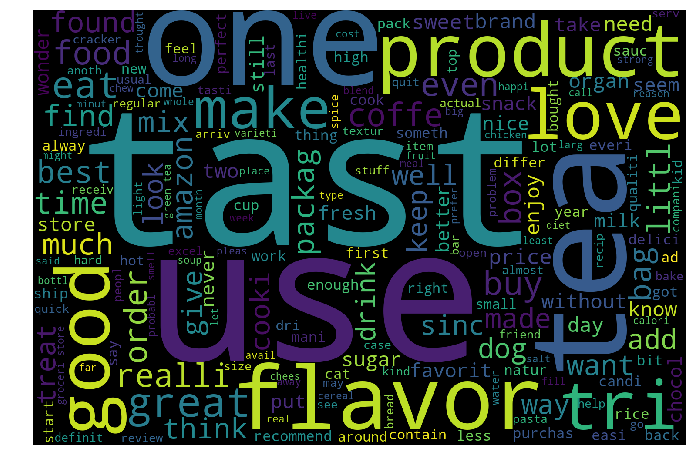

In [89]:
cloud(tfidfw2v_DF,18)

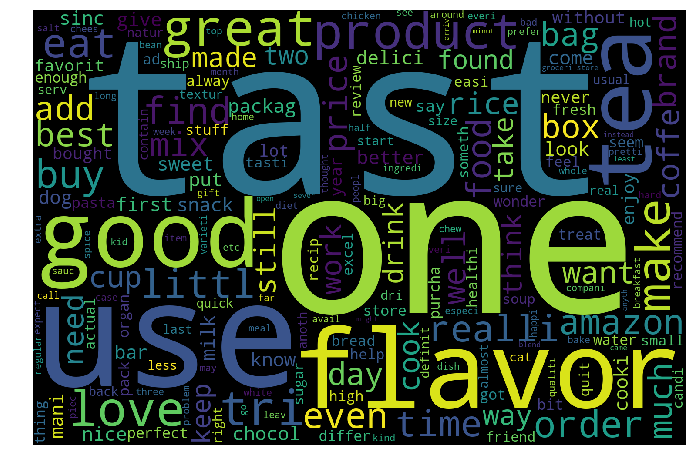

In [90]:
cloud(tfidfw2v_DF,19)

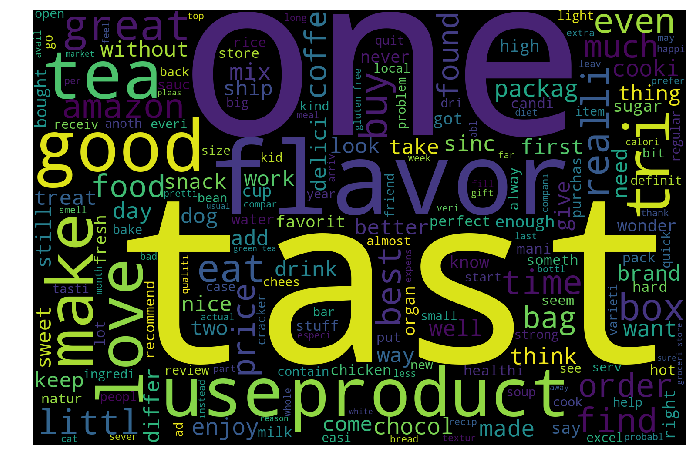

In [91]:
cloud(tfidfw2v_DF,12)

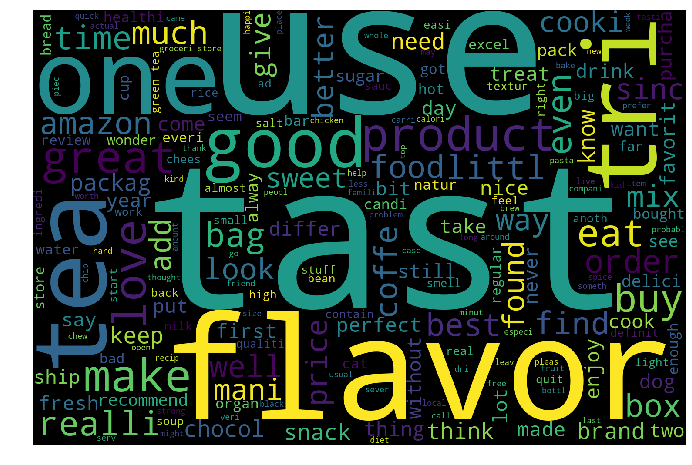

In [92]:
cloud(tfidfw2v_DF,11)

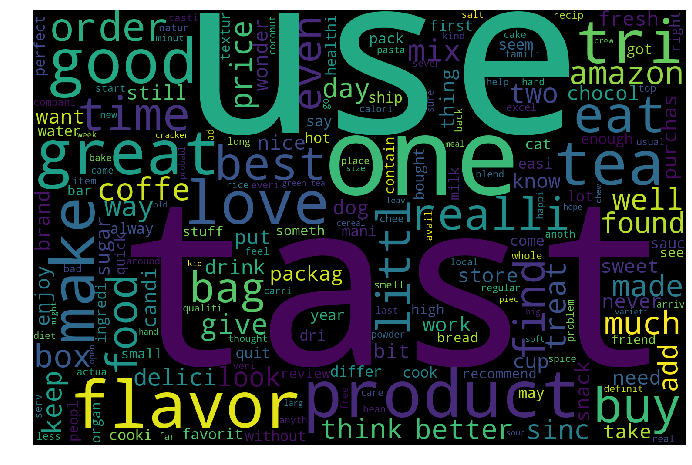

In [93]:
cloud(tfidfw2v_DF,13)

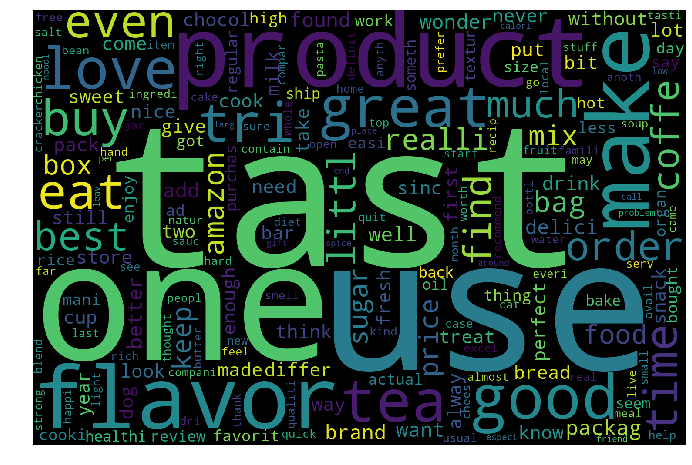

In [94]:
cloud(tfidfw2v_DF,10)

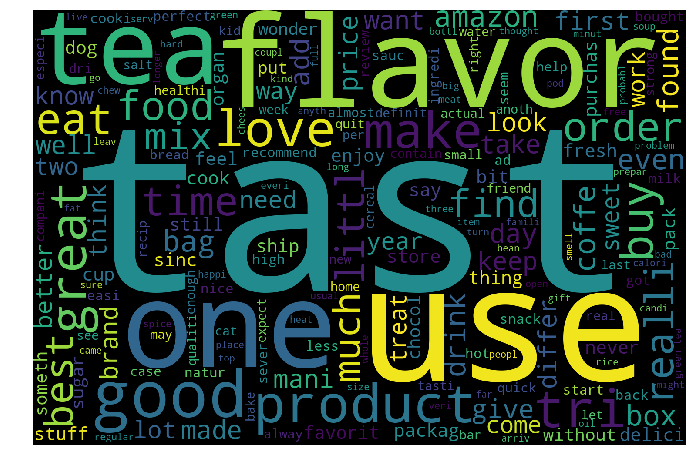

In [95]:
cloud(tfidfw2v_DF,3)

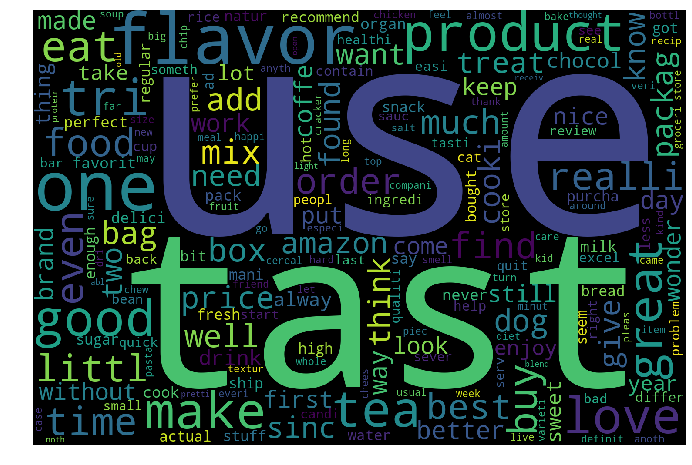

In [96]:
cloud(tfidfw2v_DF,6)

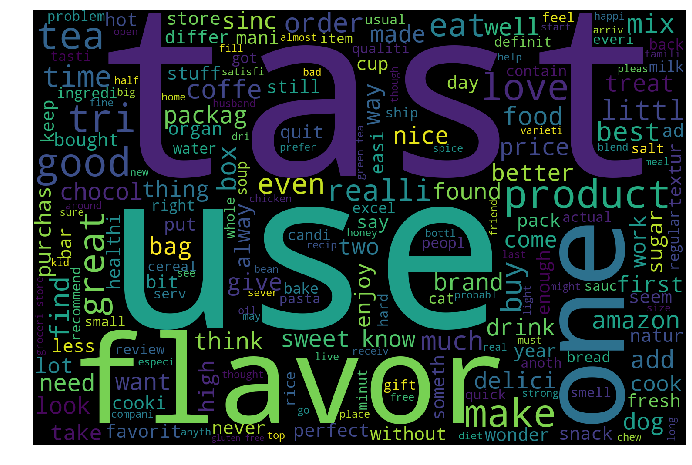

In [97]:
cloud(tfidfw2v_DF,16)

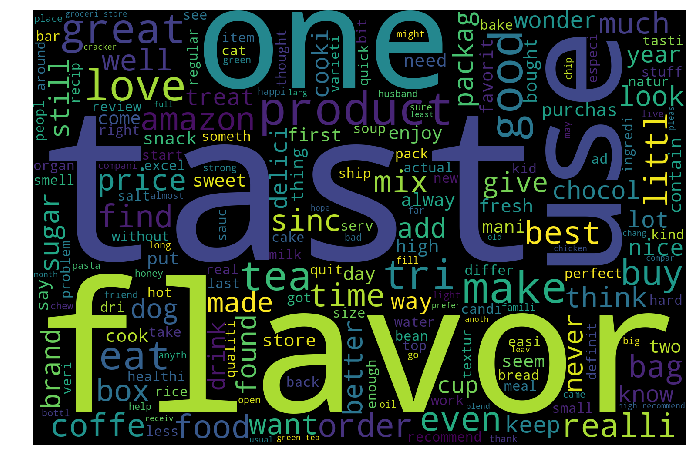

In [98]:
cloud(tfidfw2v_DF,15)

<b> Observations : </b>

Though we got multiple points under each clusters they are not groupped that well as we got in BOW and TfIDF. Here almost Tast flavour and one are the words used in reviews of all clusters. 

# <center>  -- Hierarchical clustering - AGGLOMERATIVE --

#### 2 Clusters:

In [66]:
model2=AgglomerativeClustering(n_clusters=2,linkage='average')

In [68]:
model2.fit(std_train_tfidfw2v[:5000])

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='average', memory=None,
            n_clusters=2,
            pooling_func=<function mean at 0x000002763A59B378>)

In [69]:
lb2=model2.labels_
pd.value_counts(lb2)

0    4999
1       1
dtype: int64

In [70]:
model1=AgglomerativeClustering(n_clusters=2,linkage='complete')

In [71]:
model1.fit(std_train_tfidfw2v[:5000])

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='complete', memory=None,
            n_clusters=2,
            pooling_func=<function mean at 0x000002763A59B378>)

In [72]:
lb1=model1.labels_
pd.value_counts(lb1)

1    4656
0     344
dtype: int64

In [73]:
model=AgglomerativeClustering(n_clusters=2)

In [74]:
model.fit(std_train_tfidfw2v[:5000])

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='ward', memory=None, n_clusters=2,
            pooling_func=<function mean at 0x000002763A59B378>)

In [75]:
lb=model.labels_
pd.value_counts(lb)

0    4258
1     742
dtype: int64

Among the 3 linkages, Ward linkage is working fine for this data. 

In [76]:
tmp=sorted_data['New'][:5000]
tmp=pd.DataFrame(tmp)
tmp['Cluster']=lb

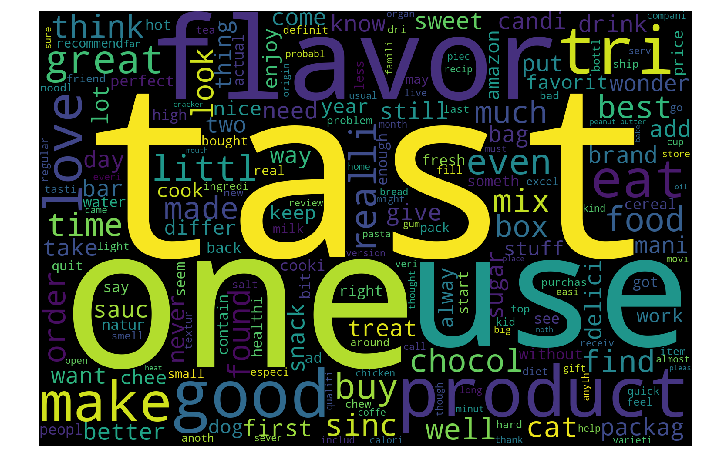

In [77]:
cloud(tmp,0)

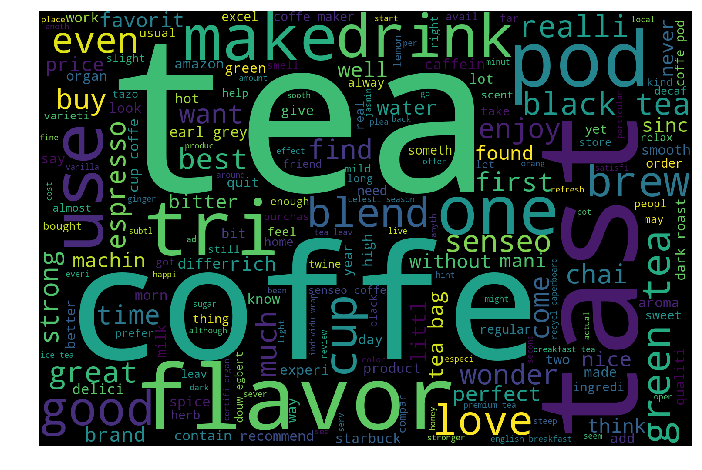

In [78]:
cloud(tmp,1)

<b> Observations : </b>

Below are some of the observations of discussion over the clusters formed,

Cluster 1 - Contains mostly used words like taste, flavour, good etc.

Cluster 0 - Tea,coffee & Espresso.

#### 5 Clusters:

In [79]:
model=AgglomerativeClustering(n_clusters=5)

In [80]:
model.fit(std_train_tfidfw2v[:5000])

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='ward', memory=None, n_clusters=5,
            pooling_func=<function mean at 0x000002763A59B378>)

In [81]:
lb=model.labels_
pd.value_counts(lb)

2    1878
0    1561
1     819
4     439
3     303
dtype: int64

In [82]:
tmp=sorted_data['New'][:5000]
tmp=pd.DataFrame(tmp)
tmp['Cluster']=lb

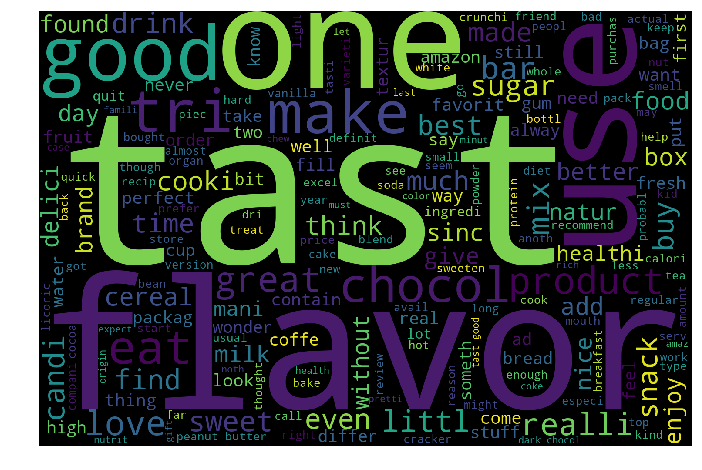

In [83]:
cloud(tmp,2)

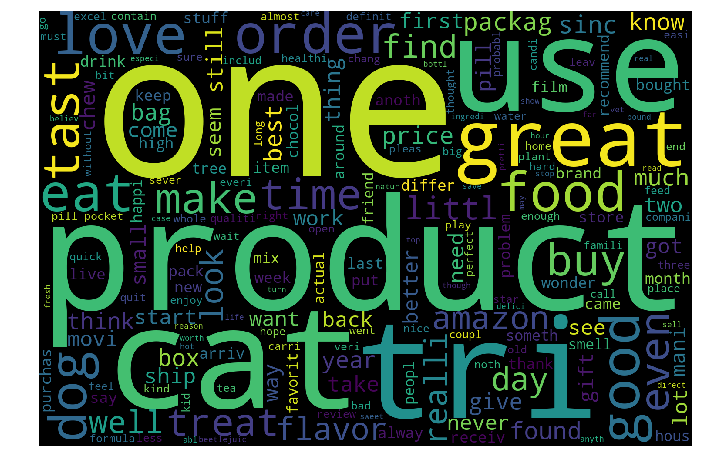

In [84]:
cloud(tmp,0)

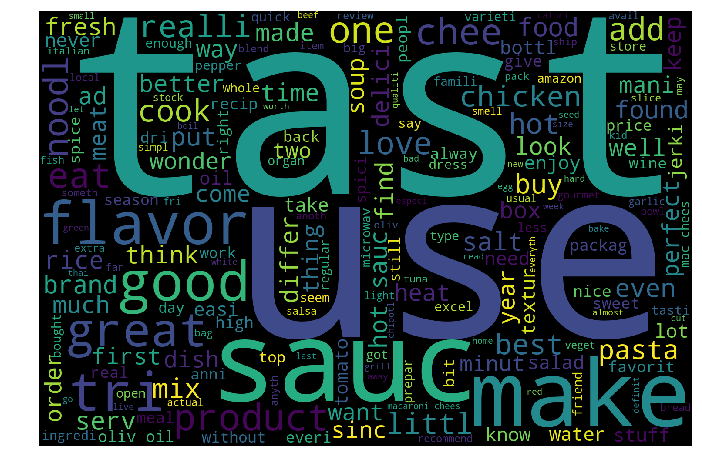

In [85]:
cloud(tmp,1)

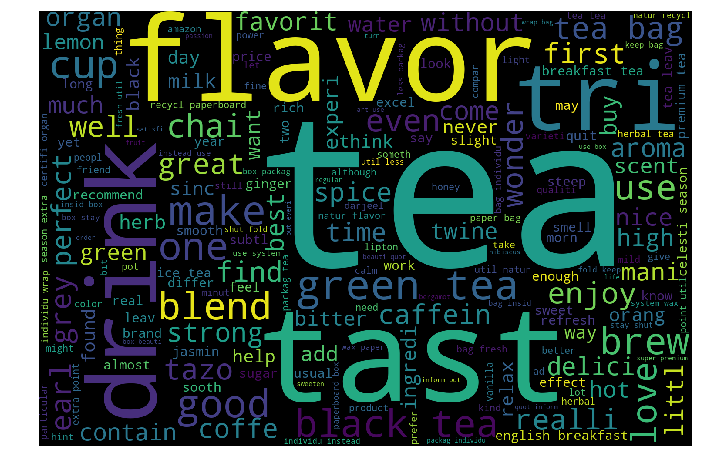

In [86]:
cloud(tmp,4)

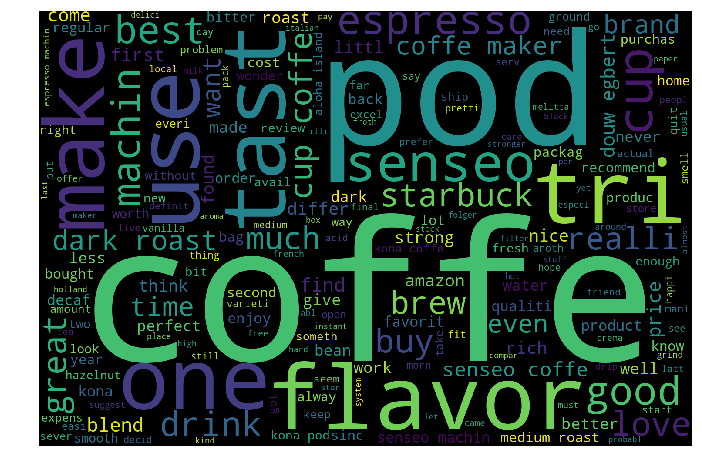

In [87]:
cloud(tmp,3)

<b> Observations : </b>

Below are some of the observations of discussion over the clusters formed,

Cluster 2 - Contains mostly used words like taste, flavour etc.

Cluster 0 - Cat , one.

Cluster 1 - taste,sauce.

Cluster 4 - Tea.

Cluster 3 - Coffee.

#### 10 Cluster:

In [88]:
model=AgglomerativeClustering(n_clusters=10)

In [89]:
model.fit(std_train_tfidfw2v[:5000])

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='ward', memory=None, n_clusters=10,
            pooling_func=<function mean at 0x000002763A59B378>)

In [90]:
lb=model.labels_
pd.value_counts(lb)

0    966
2    931
1    819
6    568
4    439
5    361
8    303
9    269
7    175
3    169
dtype: int64

In [91]:
tmp=sorted_data['New'][:5000]
tmp=pd.DataFrame(tmp)
tmp['Cluster']=lb

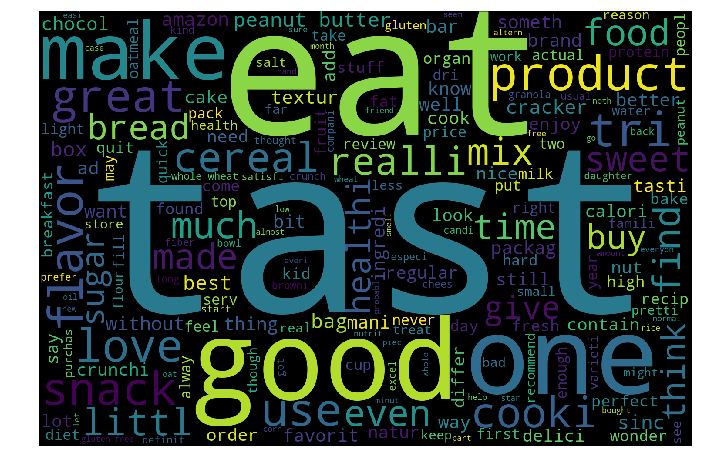

In [92]:
cloud(tmp,0)

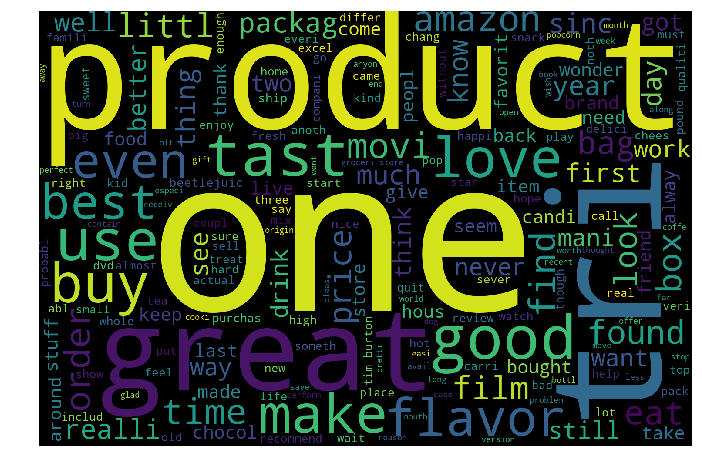

In [93]:
cloud(tmp,2)

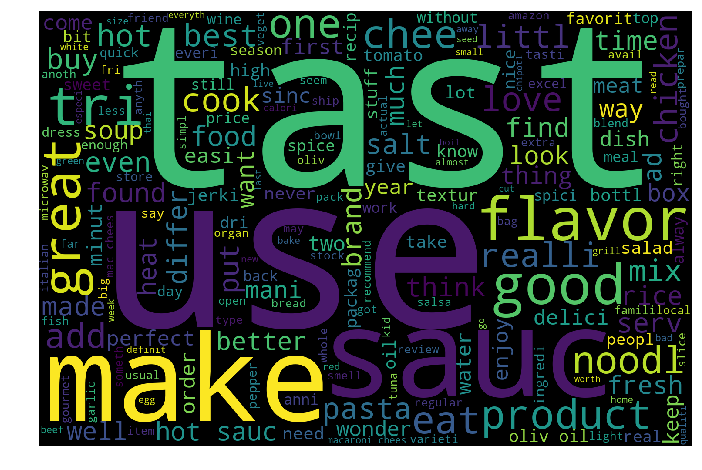

In [94]:
cloud(tmp,1)

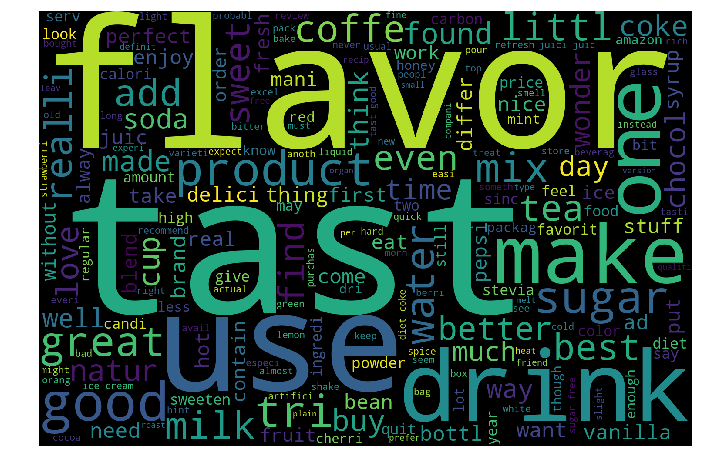

In [95]:
cloud(tmp,6)

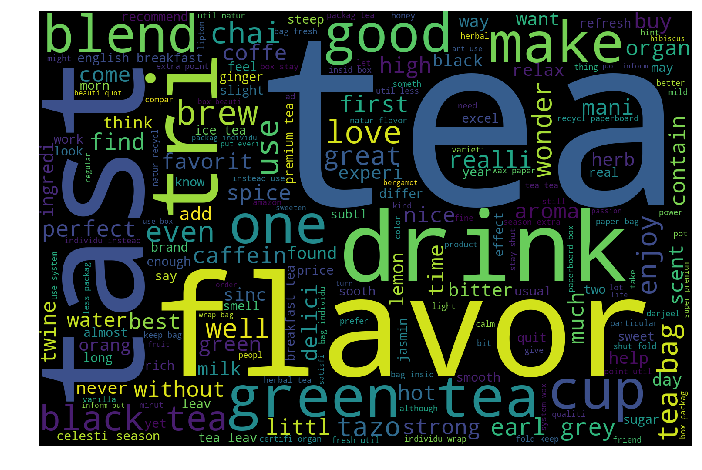

In [96]:
cloud(tmp,4)

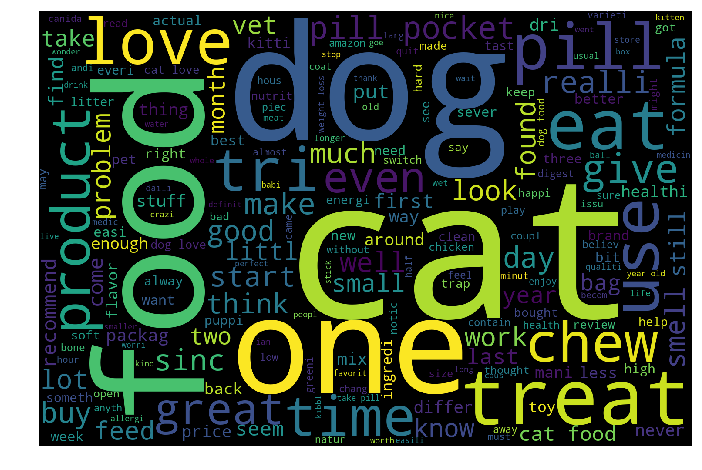

In [97]:
cloud(tmp,5)

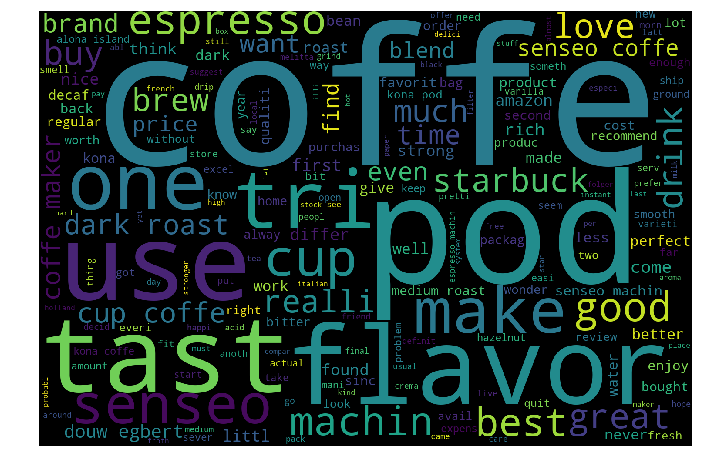

In [98]:
cloud(tmp,8)

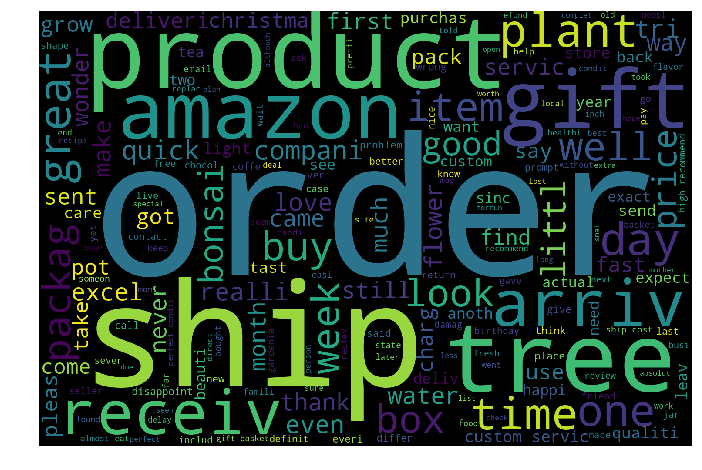

In [99]:
cloud(tmp,9)

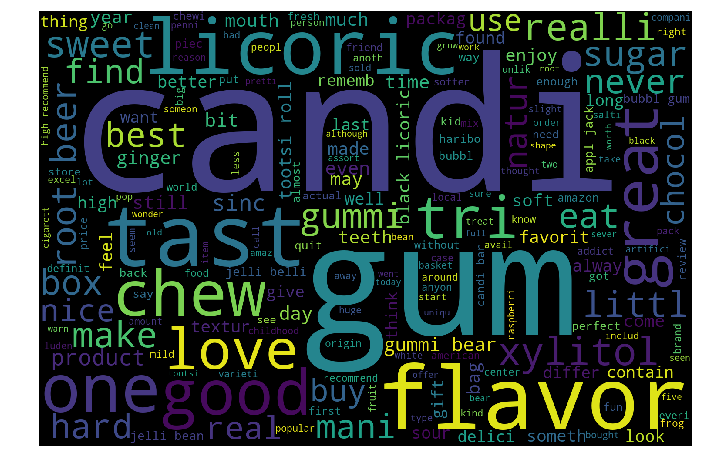

In [100]:
cloud(tmp,7)

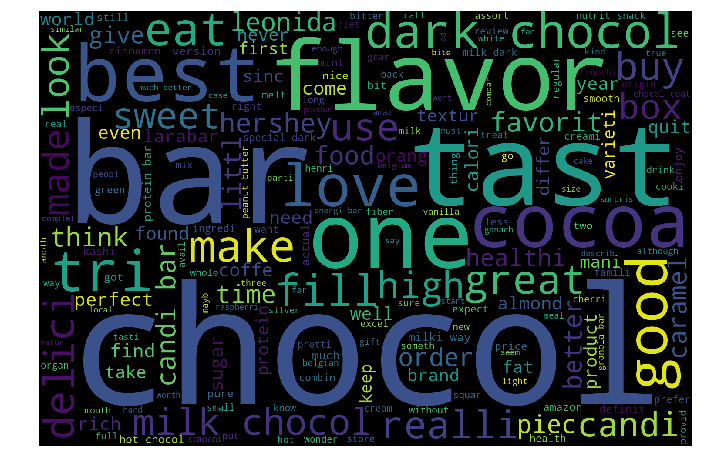

In [101]:
cloud(tmp,3)

<b> Observations : </b>

Below are some of the observations of discussion over the clusters formed,

Cluster 2 - Contains mostly used words like taste, flavour etc.

Cluster 0 - Cat , one.

Cluster 1 - taste,sauce.

Cluster 4 - Tea.

Cluster 6 - Dog & Cat.

Cluster 8 - Cofee.

Cluster 9 - Ship, order

Cluster 7 - Candy, gum

Cluster 3 - Chocolate,cocoa.

# <center>  -- DBSCAN  --

In [17]:
scaler=StandardScaler(with_mean=False)
std_train_tfidfw2v=scaler.fit_transform(train_tfidf_w2v[:25000])

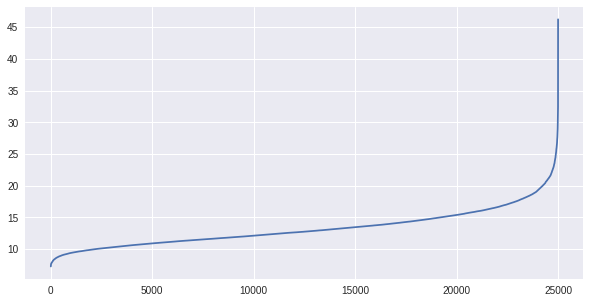

In [38]:
eps_elbow(std_train_tfidfw2v,400)

In [0]:
model=DBSCAN(eps=20,min_samples=400)

In [44]:
model.fit(std_train_tfidfw2v)

DBSCAN(algorithm='auto', eps=20, leaf_size=30, metric='euclidean',
    metric_params=None, min_samples=400, n_jobs=None, p=None)

In [45]:
lb=model.labels_
pd.value_counts(lb)

 0    24995
-1        5
dtype: int64

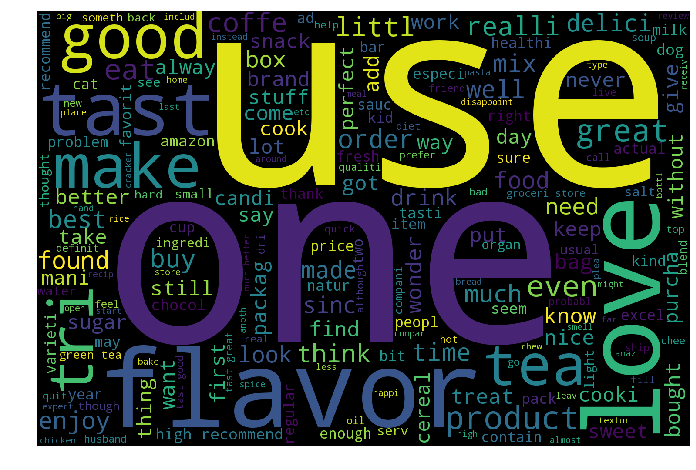

In [47]:
cloud(tmp,0)

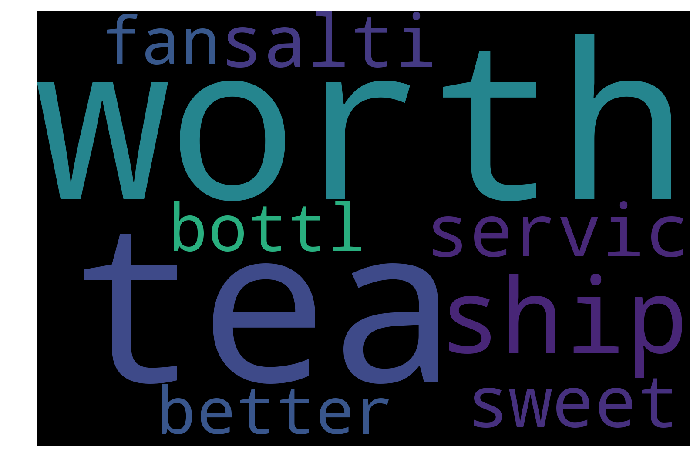

In [48]:
cloud(tmp,-1)

<b> Observations : </b>

5 points are classified as outlier points under cluster -1,

Cluster 0 contains almost of the overlapped data points within a single cluster.

# Conclusion from above exercise:

1.) K means seems to be faster and more space effective when compared to other type of clusterings.

2.) Agglomerative is good in Clustering, in all 4 vectorizations, Agglomerative is the one which well seperated reviews of different topics into different clusters like tea, cofee, dog, sauce.

3.) DBSCAN desn't seem to work well here, It can be used only to get the outlier points on the given data.


*****************************************************************************************************************************

#### From above exercise If we know the exact number of clusters to be formed, Aggomerative seems to be a better one with the cost of time complexity.
